In [186]:
import numpy as np
import shutil
import os, random
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
import gender_guesser.detector as gender_detector

In [187]:
%matplotlib inline

In [188]:
LIKE_PATH = os.path.join('data', 'likes')
DISLIKE_PATH = os.path.join('data', 'dislikes')
LFW_DIR = 'lfw'
d = gender_detector.Detector()

In [189]:
# Save user in like or dislike folder
def save_user_swipe(username, gender, directory_path):
    swipe = None
    file_path = random.choice(os.listdir(directory_path))
    img = Image.open(os.path.join(directory_path, file_path))
    imgplot = plt.imshow(img)
    title = '{username} / {gender}'.format(username = username, gender = gender)
    plt.title(title)
    plt.show()
    while swipe != 'l' and swipe != 'd':
        swipe = input("What do you think of this person?")
        if swipe == 'l':
            shutil.copytree(directory_path, LIKE_PATH, dirs_exist_ok=True)
            print(username, 'saved on like')
        elif swipe == 'd':
            shutil.copytree(directory_path, DISLIKE_PATH, dirs_exist_ok=True)
            print(username, 'saved on dislike')
        elif swipe == 'end':
            print('------------ENDING----------')
            break
        else:
            print('Invalid input - type l for like and d for dislike')
    return swipe

In [190]:
# Get total of males / females / undeterminate users and pictures in directory
def directory_gender_info(directory_path):
    d = gender_detector.Detector()
    male = 0
    male_pictures = 0
    female = 0
    female_pictures = 0
    undeterminate = 0
    undeterminate_pictures = 0
    for directory in os.listdir(directory_path):
        if directory == '.DS_Store':
            continue
        username = directory.replace('_', ' ')
        gender = d.get_gender(username.split()[0])
        if os.path.isdir(os.path.join(directory_path, directory)):
            _, _, files = next(os.walk(os.path.join(directory_path, directory)))
            file_count = len(files)
        else:
            file_count = 1
        if gender == 'female' or gender == 'mostly_female':
            female +=1
            female_pictures += file_count
        elif gender == 'male' or gender == 'mostly_male':
            male +=1
            male_pictures += file_count
        elif gender == 'unknown' or gender == 'andy':
            undeterminate +=1
            undeterminate_pictures += file_count
        else:
            print('gender fail', gender)
    # Print info of directory
    print('Printing information of', directory_path,
      '\n\nfemales =', female, 'female pictures =', female_pictures,
      '\nmale =', male, 'male pictures =', male_pictures,
      '\nundeterminate =', undeterminate, 'undeterminate pictures =', undeterminate_pictures,
      '\ntotal people =',
      female + male + undeterminate,
      'total pictures', 
      female_pictures + male_pictures + undeterminate_pictures
     )

In [191]:
def clean_directory(directory_path):
    for file_name in os.listdir(directory_path):
        # construct full file path
        file = os.path.join(directory_path, file_name)
        if os.path.isfile(file):
            print('Deleting file:', file)
            os.remove(file)

In [214]:
clean_directory(LIKE_PATH)
clean_directory(DISLIKE_PATH)

Deleting file: data/likes/Maggie_Smith_0002.jpg
Deleting file: data/likes/Maggie_Smith_0001.jpg
Deleting file: data/likes/Terry_Lynn_Barton_0001.jpg
Deleting file: data/likes/Celine_Dion_0004.jpg
Deleting file: data/likes/Kate_Hudson_0009.jpg
Deleting file: data/likes/Kate_Hudson_0008.jpg
Deleting file: data/likes/Celine_Dion_0005.jpg
Deleting file: data/likes/Celine_Dion_0007.jpg
Deleting file: data/likes/Celine_Dion_0006.jpg
Deleting file: data/likes/Celine_Dion_0002.jpg
Deleting file: data/likes/Emmanuelle_Beart_0001.jpg
Deleting file: data/likes/Celine_Dion_0003.jpg
Deleting file: data/likes/Blythe_Danner_0001.jpg
Deleting file: data/likes/Celine_Dion_0001.jpg
Deleting file: data/likes/Emmanuelle_Beart_0002.jpg
Deleting file: data/likes/Emmanuelle_Beart_0003.jpg
Deleting file: data/likes/Blythe_Danner_0002.jpg
Deleting file: data/likes/Selma_Phoenix_0001.jpg
Deleting file: data/likes/Kate_Hudson_0001.jpg
Deleting file: data/likes/Kate_Hudson_0003.jpg
Deleting file: data/likes/Rache

In [217]:
directory_gender_info(LIKE_PATH)
directory_gender_info(DISLIKE_PATH)

Printing information of data/likes 

females = 51 female pictures = 51 
male = 0 male pictures = 0 
undeterminate = 4 undeterminate pictures = 4 
total people = 55 total pictures 55
Printing information of data/dislikes 

females = 42 female pictures = 42 
male = 300 male pictures = 300 
undeterminate = 30 undeterminate pictures = 30 
total people = 372 total pictures 372


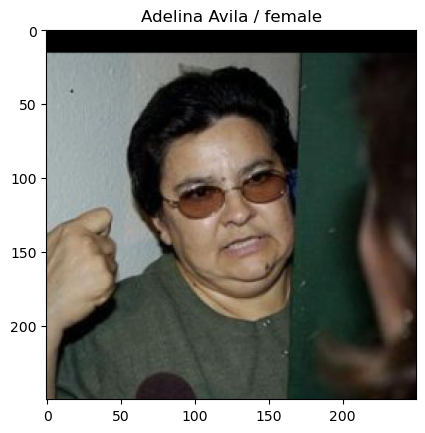

What do you think of this person?d
Adelina Avila saved on dislike


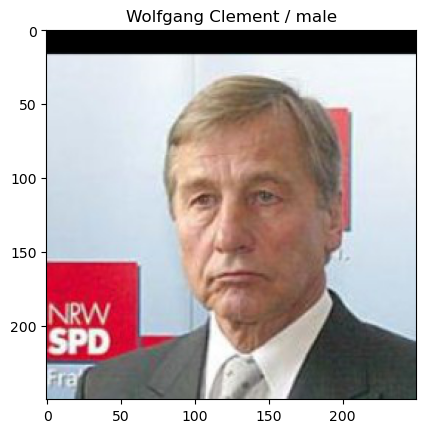

What do you think of this person?d
Wolfgang Clement saved on dislike


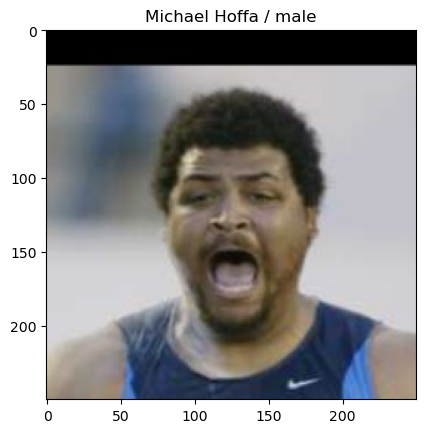

What do you think of this person?d
Michael Hoffa saved on dislike


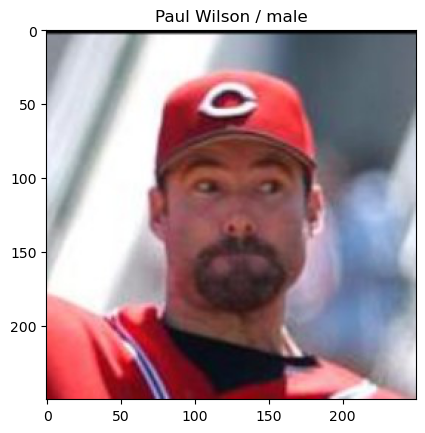

What do you think of this person?d
Paul Wilson saved on dislike


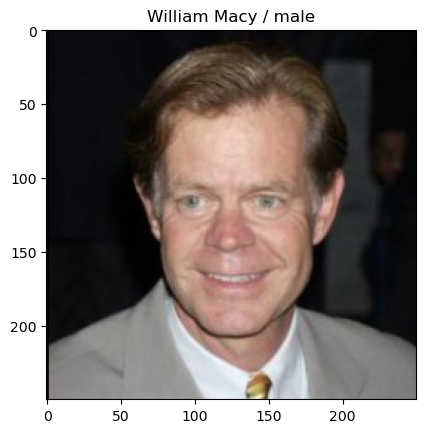

What do you think of this person?d
William Macy saved on dislike


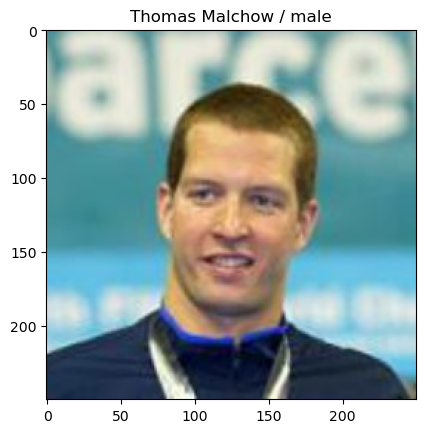

What do you think of this person?d
Thomas Malchow saved on dislike


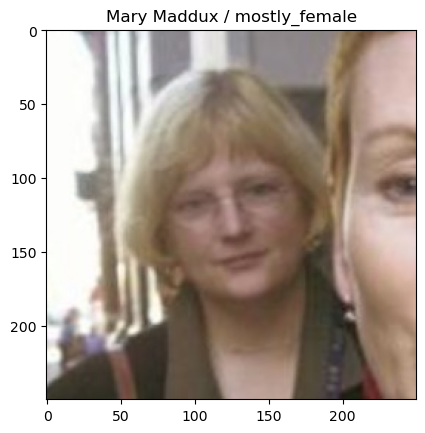

What do you think of this person?d
Mary Maddux saved on dislike


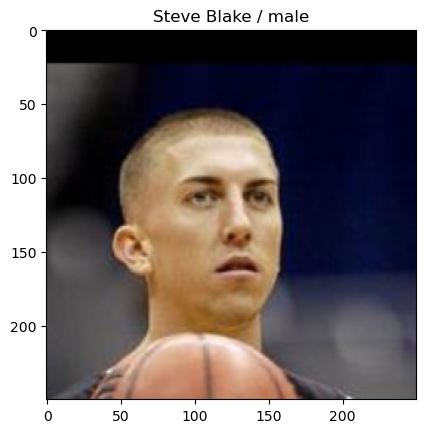

What do you think of this person?d
Steve Blake saved on dislike


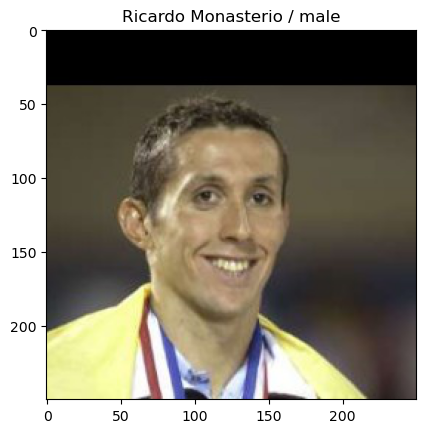

What do you think of this person?d
Ricardo Monasterio saved on dislike


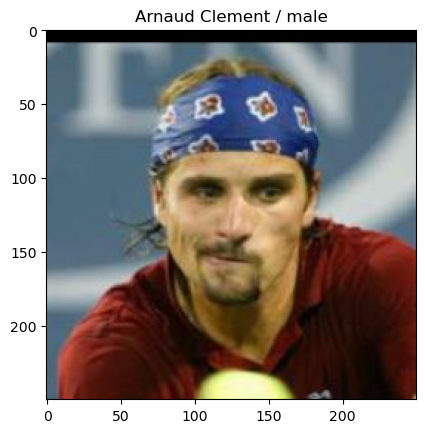

What do you think of this person?d
Arnaud Clement saved on dislike


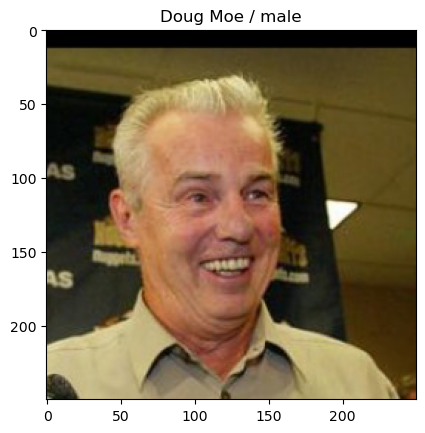

What do you think of this person?d
Doug Moe saved on dislike


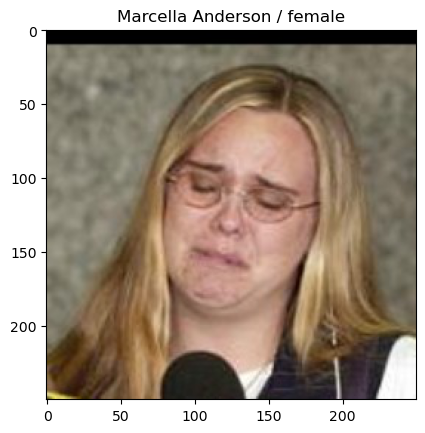

What do you think of this person?l
Marcella Anderson saved on like


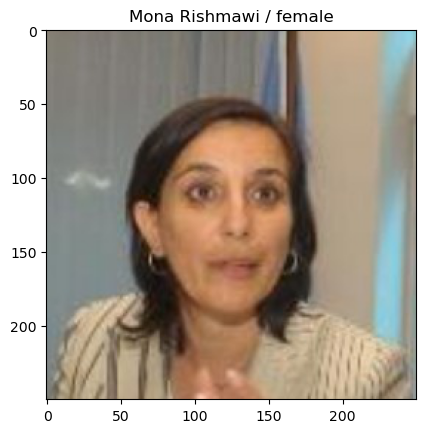

What do you think of this person?l
Mona Rishmawi saved on like


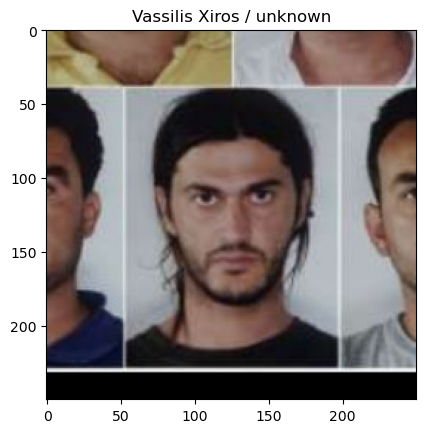

What do you think of this person?d
Vassilis Xiros saved on dislike


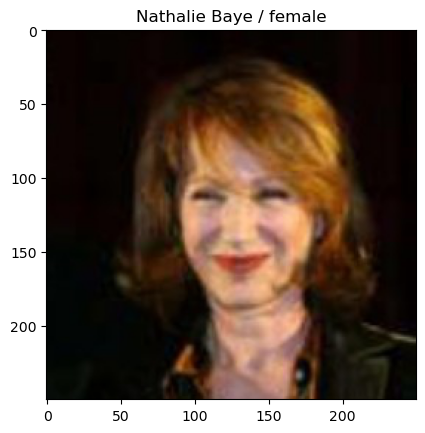

What do you think of this person?d
Nathalie Baye saved on dislike


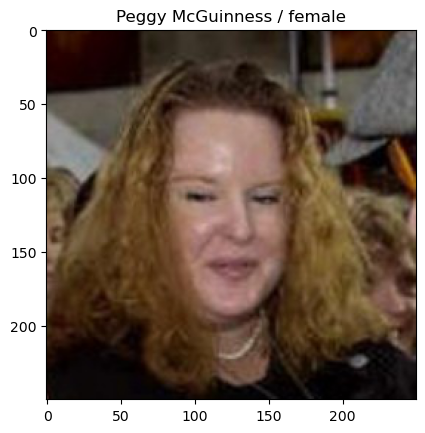

What do you think of this person?d
Peggy McGuinness saved on dislike


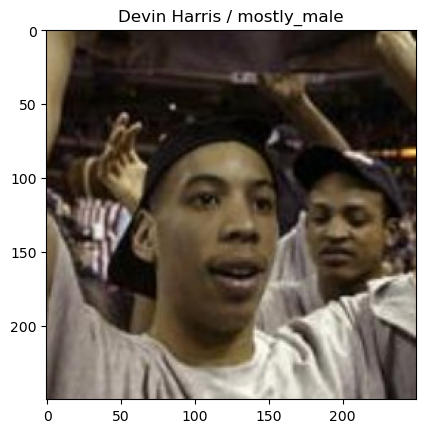

What do you think of this person?d
Devin Harris saved on dislike


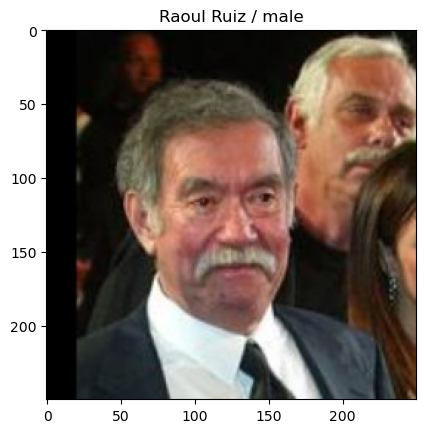

What do you think of this person?d
Raoul Ruiz saved on dislike


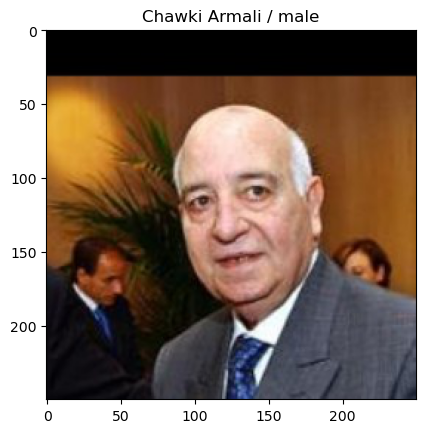

What do you think of this person?d
Chawki Armali saved on dislike


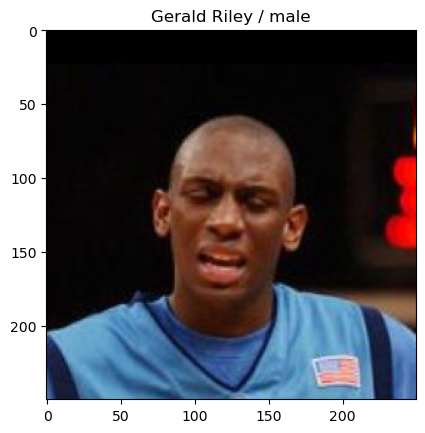

What do you think of this person?d
Gerald Riley saved on dislike


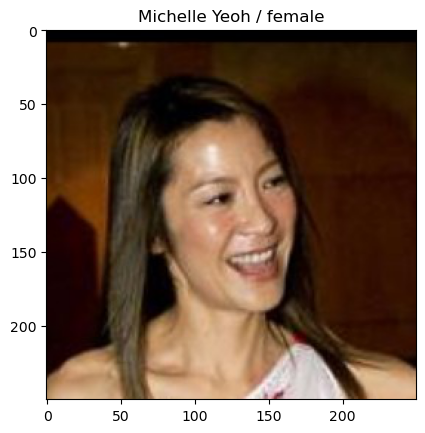

What do you think of this person?l
Michelle Yeoh saved on like


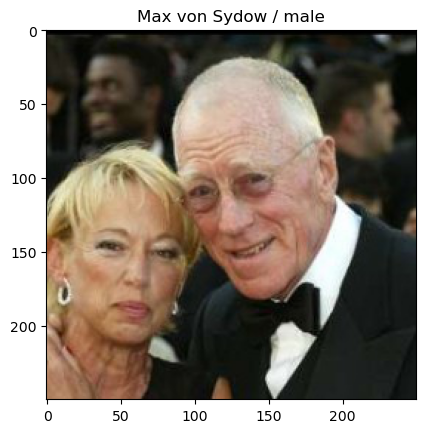

What do you think of this person?d
Max von Sydow saved on dislike


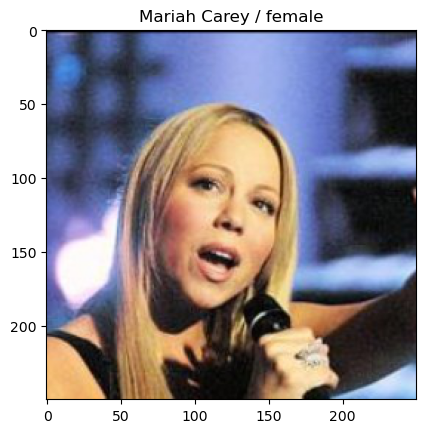

What do you think of this person?l
Mariah Carey saved on like


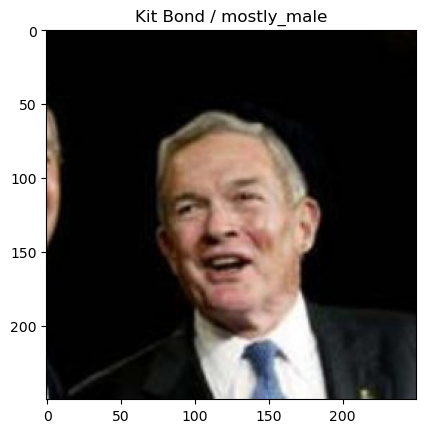

What do you think of this person?d
Kit Bond saved on dislike


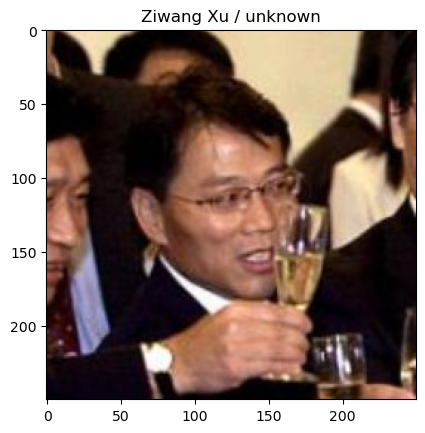

What do you think of this person?d
Ziwang Xu saved on dislike


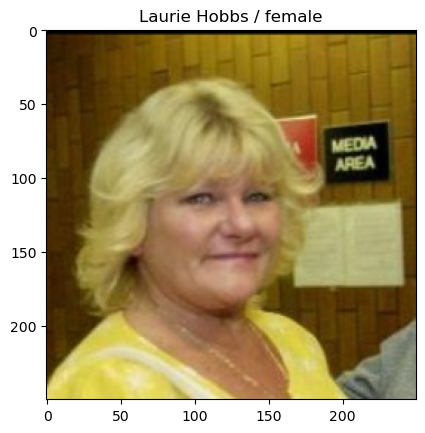

What do you think of this person?d
Laurie Hobbs saved on dislike


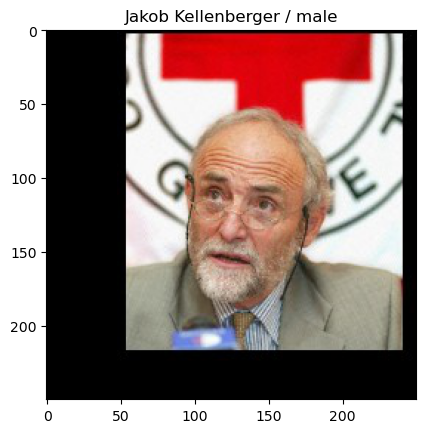

What do you think of this person?d
Jakob Kellenberger saved on dislike


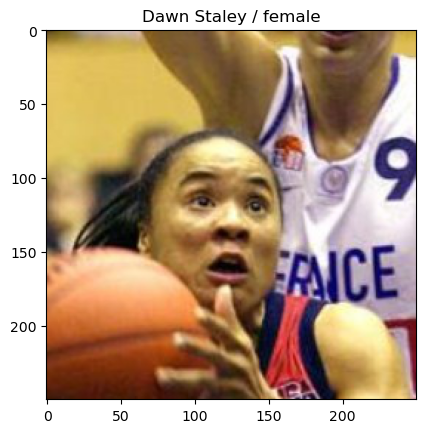

What do you think of this person?d
Dawn Staley saved on dislike


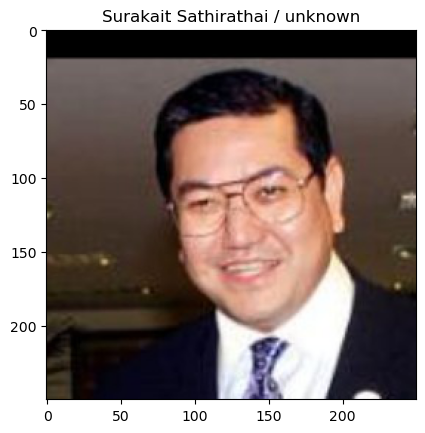

What do you think of this person?d
Surakait Sathirathai saved on dislike


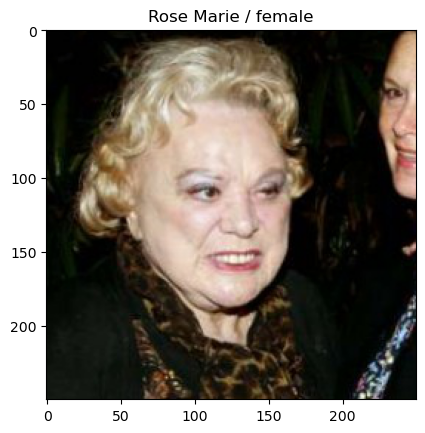

What do you think of this person?d
Rose Marie saved on dislike


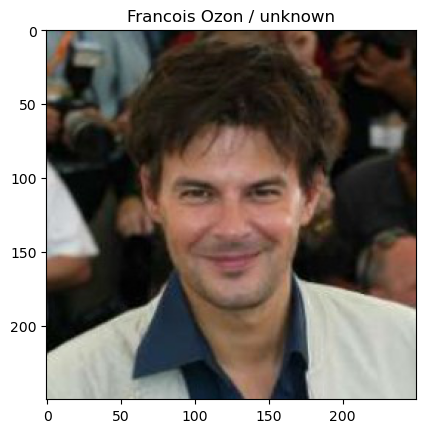

What do you think of this person?d
Francois Ozon saved on dislike


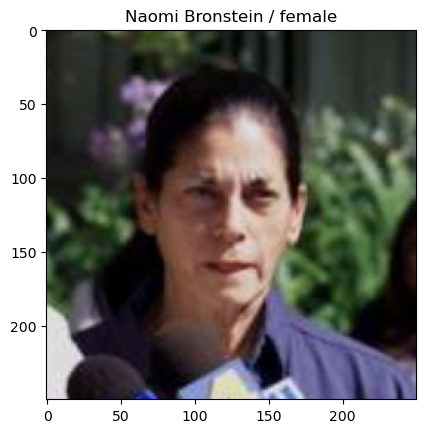

What do you think of this person?d
Naomi Bronstein saved on dislike


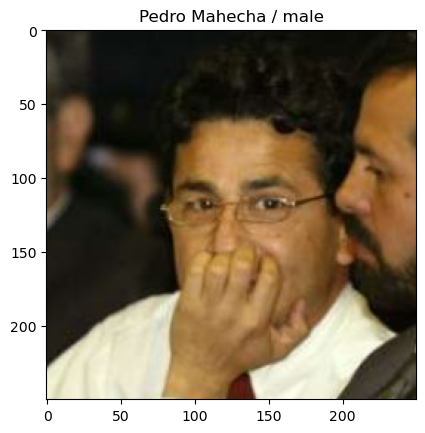

What do you think of this person?d
Pedro Mahecha saved on dislike


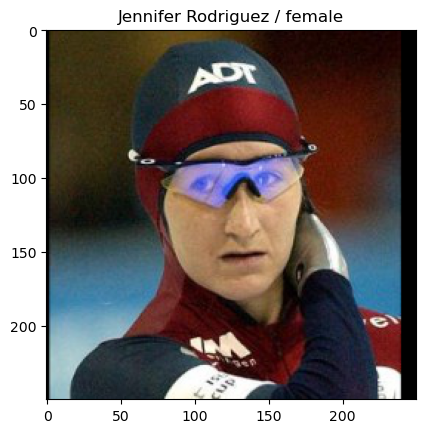

What do you think of this person?d
Jennifer Rodriguez saved on dislike


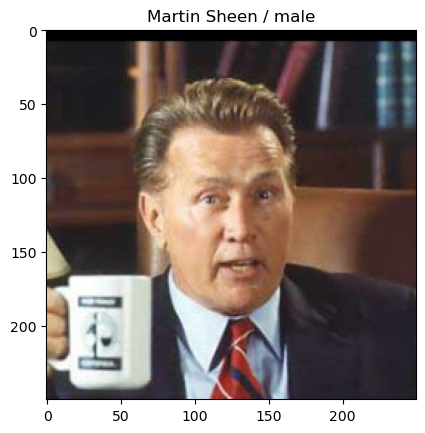

What do you think of this person?d
Martin Sheen saved on dislike


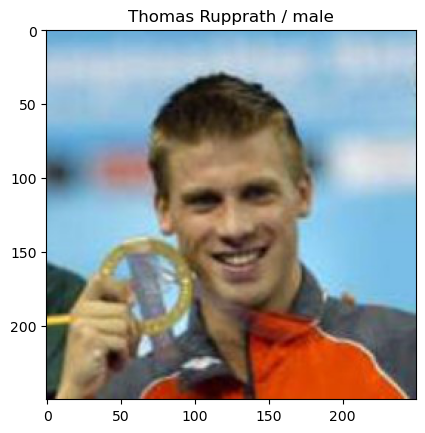

What do you think of this person?d
Thomas Rupprath saved on dislike


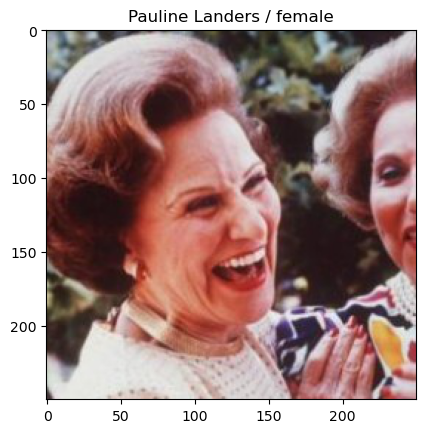

What do you think of this person?d
Pauline Landers saved on dislike


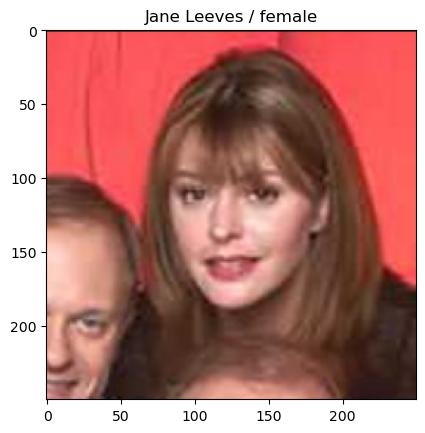

What do you think of this person?l
Jane Leeves saved on like


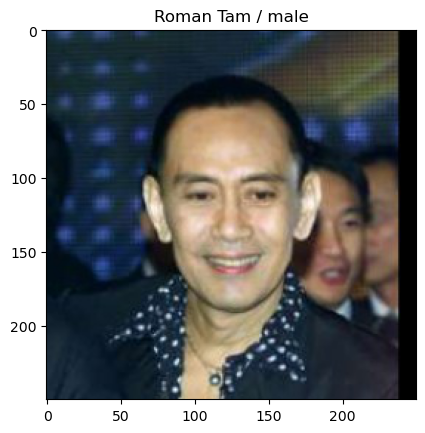

What do you think of this person?d
Roman Tam saved on dislike


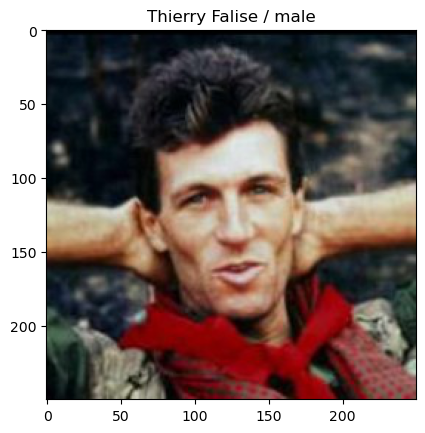

What do you think of this person?d
Thierry Falise saved on dislike


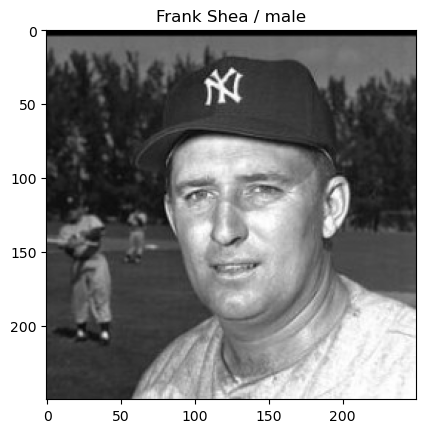

What do you think of this person?d
Frank Shea saved on dislike


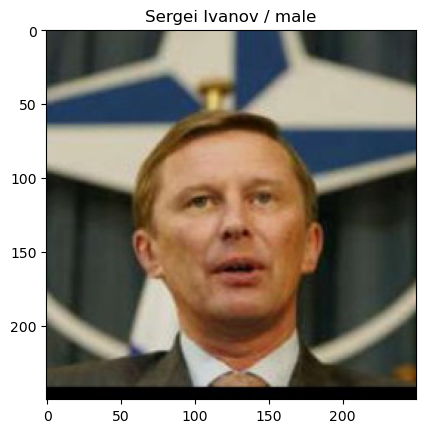

What do you think of this person?d
Sergei Ivanov saved on dislike


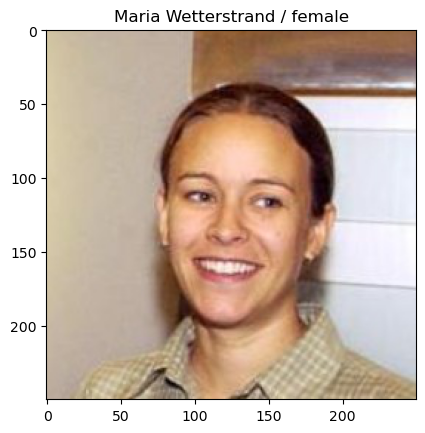

What do you think of this person?l
Maria Wetterstrand saved on like


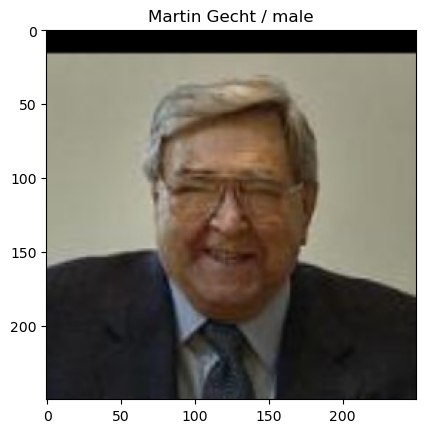

What do you think of this person?d
Martin Gecht saved on dislike


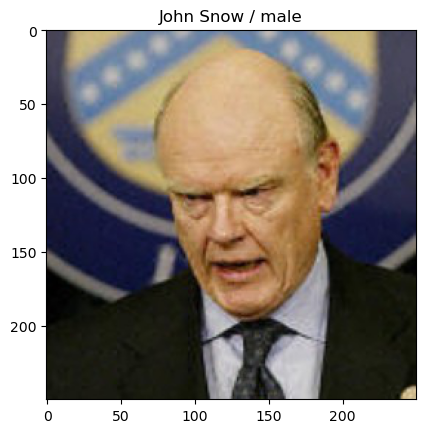

What do you think of this person?d
John Snow saved on dislike


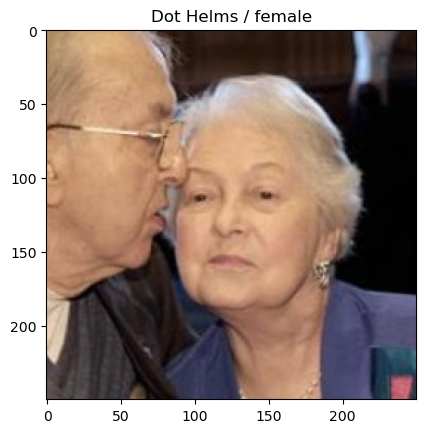

What do you think of this person?d
Dot Helms saved on dislike


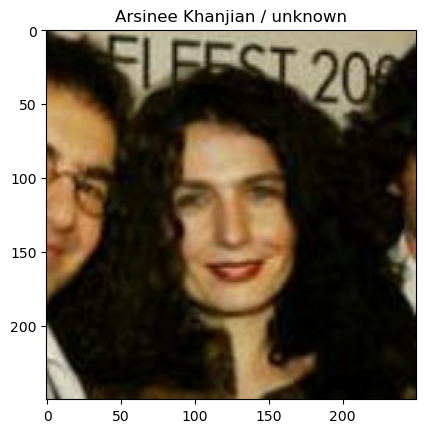

What do you think of this person?l
Arsinee Khanjian saved on like


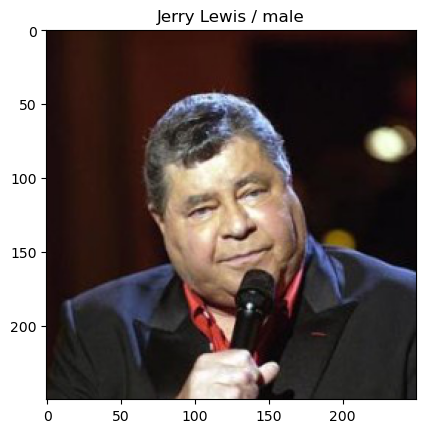

What do you think of this person?d
Jerry Lewis saved on dislike


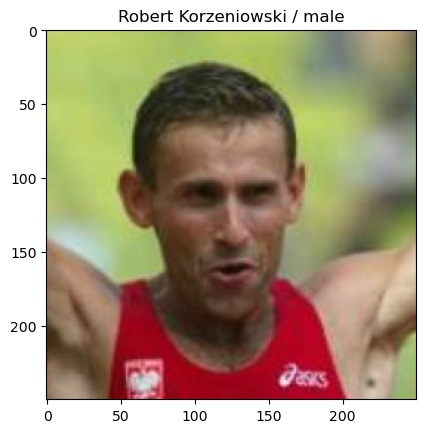

What do you think of this person?d
Robert Korzeniowski saved on dislike


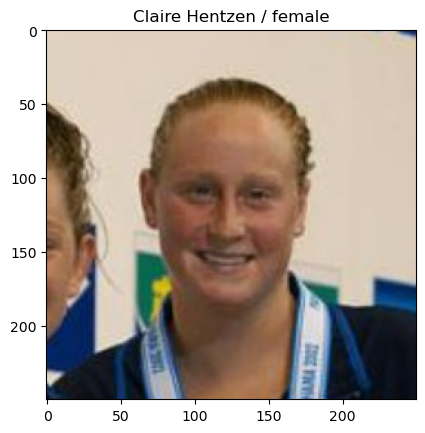

What do you think of this person?d
Claire Hentzen saved on dislike


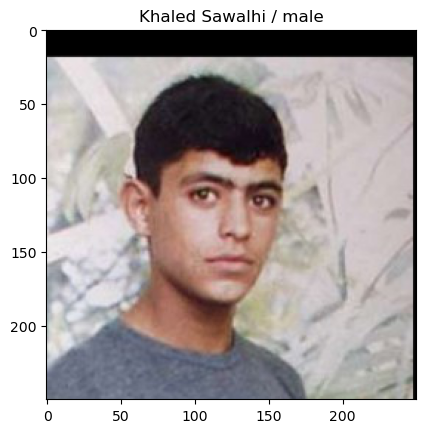

What do you think of this person?d
Khaled Sawalhi saved on dislike


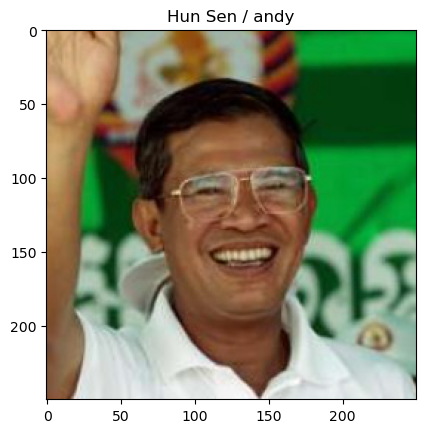

What do you think of this person?d
Hun Sen saved on dislike


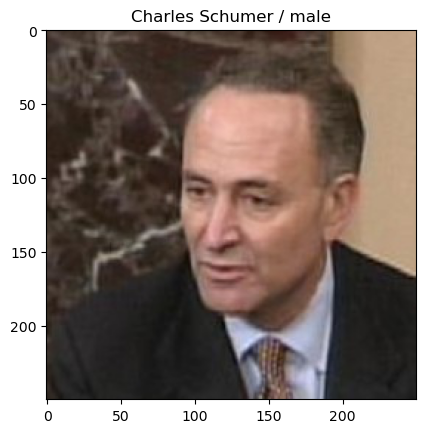

What do you think of this person?d
Charles Schumer saved on dislike


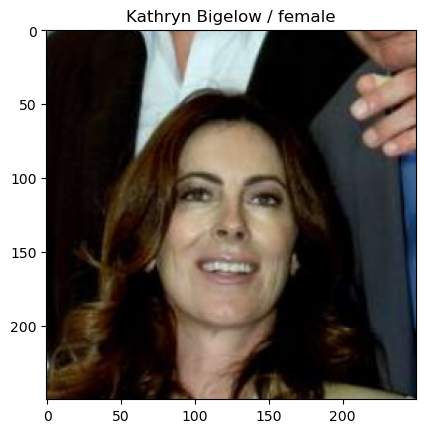

What do you think of this person?l
Kathryn Bigelow saved on like


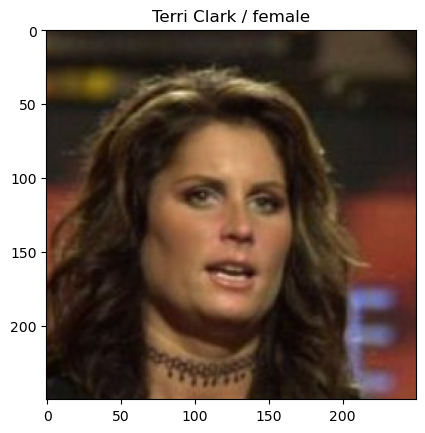

What do you think of this person?l
Terri Clark saved on like


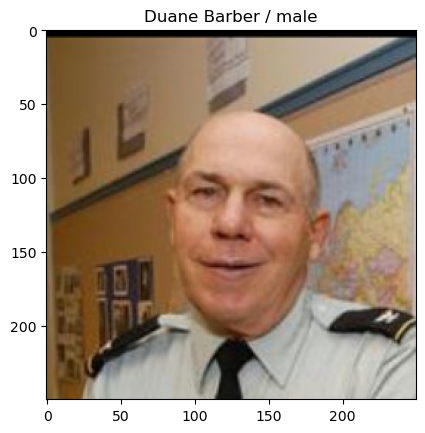

What do you think of this person?d
Duane Barber saved on dislike


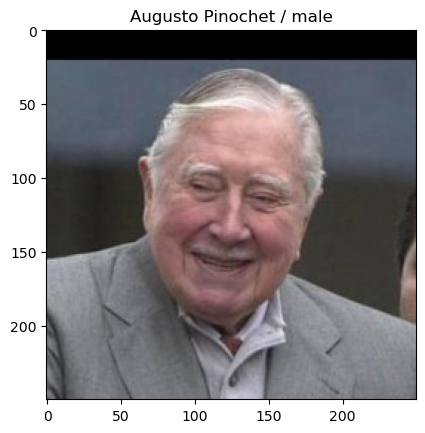

What do you think of this person?d
Augusto Pinochet saved on dislike


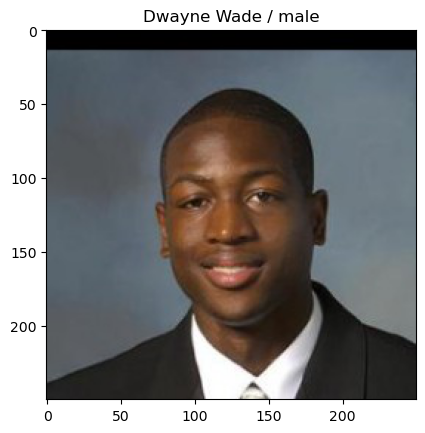

What do you think of this person?d
Dwayne Wade saved on dislike


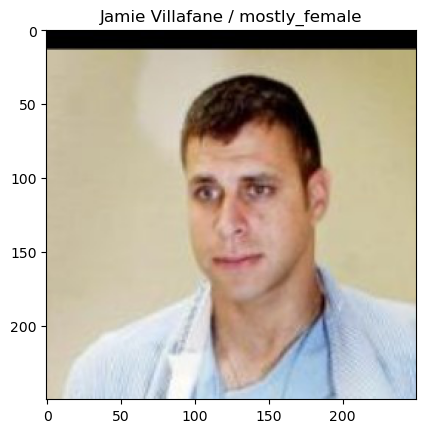

What do you think of this person?d
Jamie Villafane saved on dislike


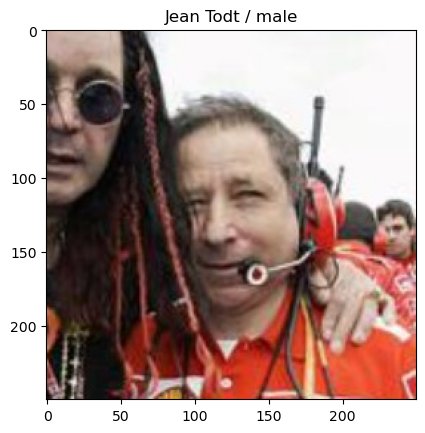

What do you think of this person?d
Jean Todt saved on dislike


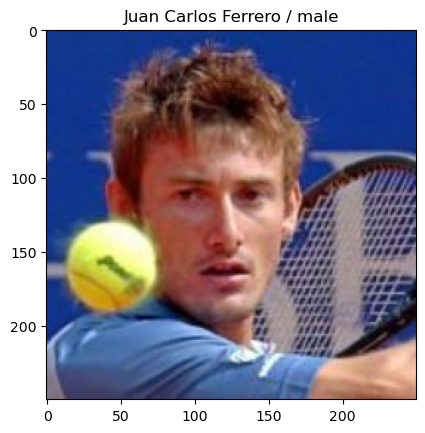

What do you think of this person?d
Juan Carlos Ferrero saved on dislike


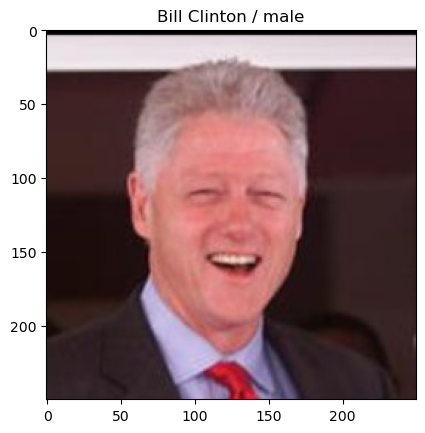

What do you think of this person?d
Bill Clinton saved on dislike


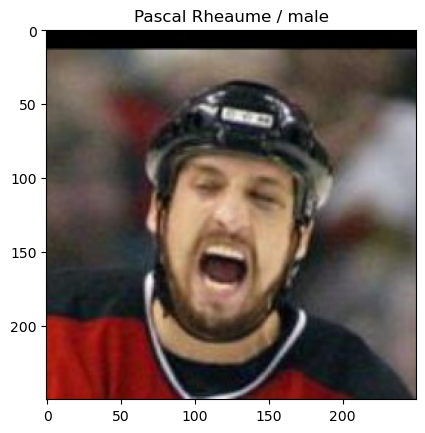

What do you think of this person?d
Pascal Rheaume saved on dislike


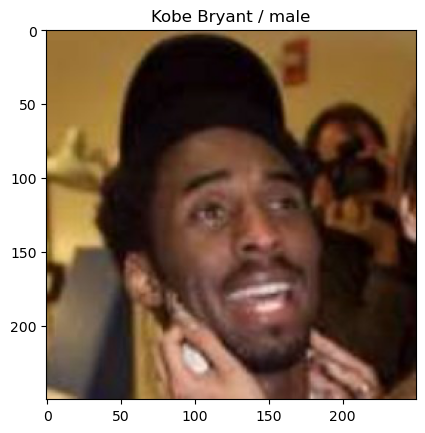

What do you think of this person?d
Kobe Bryant saved on dislike


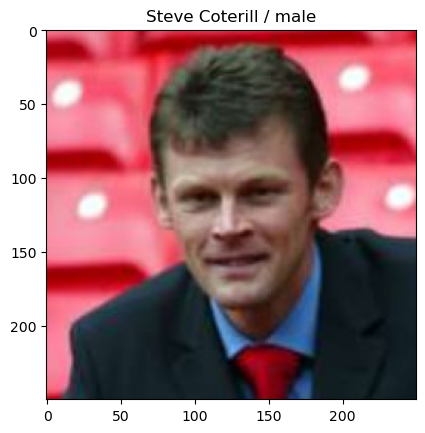

What do you think of this person?d
Steve Coterill saved on dislike


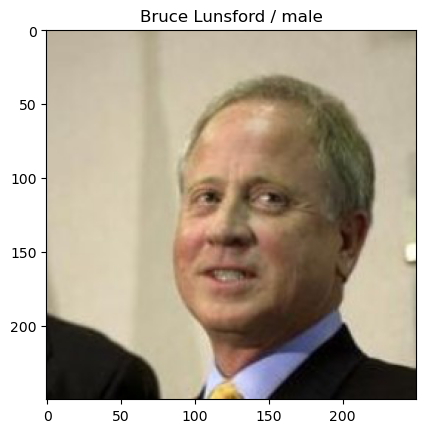

What do you think of this person?d
Bruce Lunsford saved on dislike


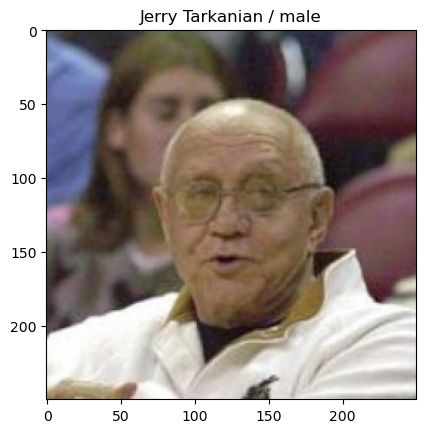

What do you think of this person?d
Jerry Tarkanian saved on dislike


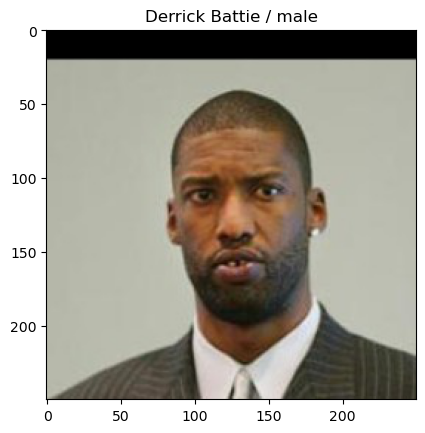

What do you think of this person?d
Derrick Battie saved on dislike


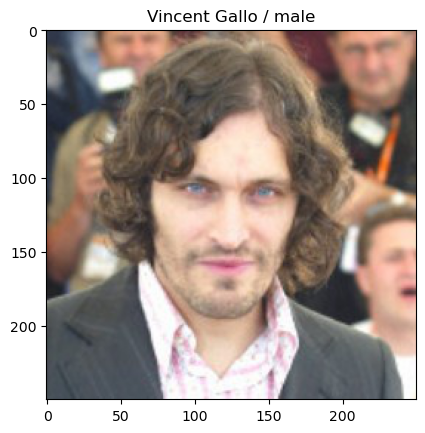

What do you think of this person?d
Vincent Gallo saved on dislike


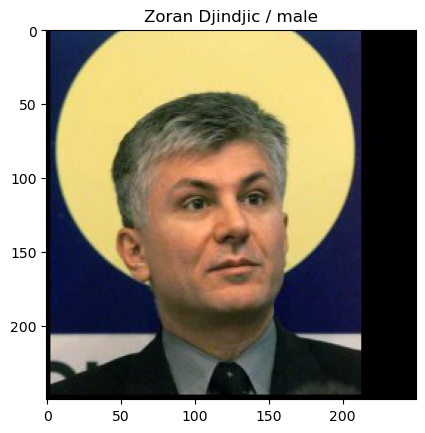

What do you think of this person?d
Zoran Djindjic saved on dislike


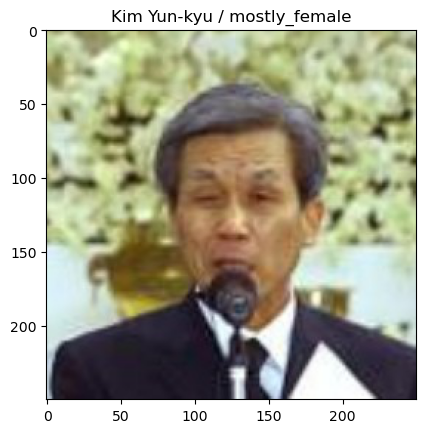

What do you think of this person?d
Kim Yun-kyu saved on dislike


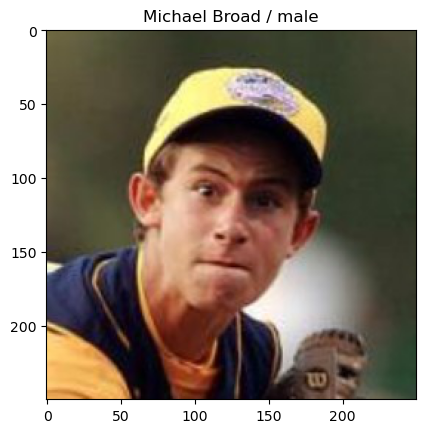

What do you think of this person?d
Michael Broad saved on dislike


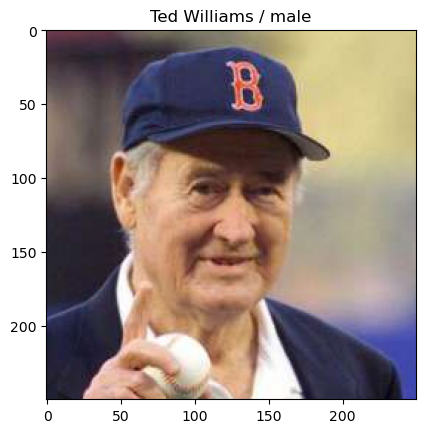

What do you think of this person?d
Ted Williams saved on dislike


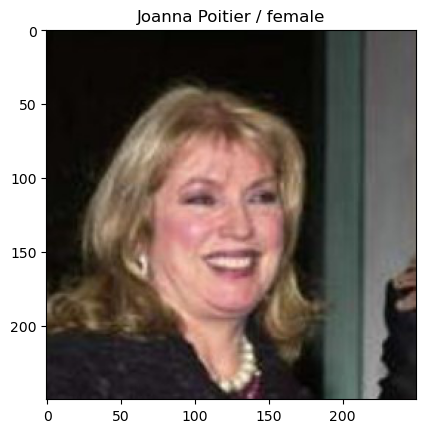

What do you think of this person?l
Joanna Poitier saved on like


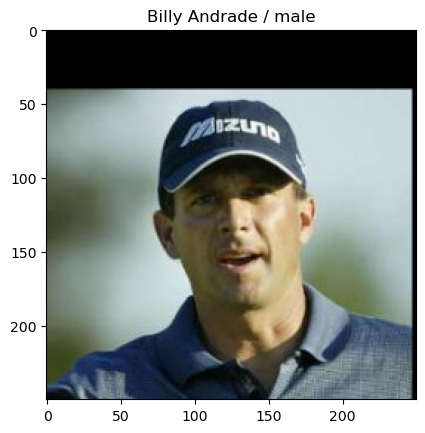

What do you think of this person?d
Billy Andrade saved on dislike


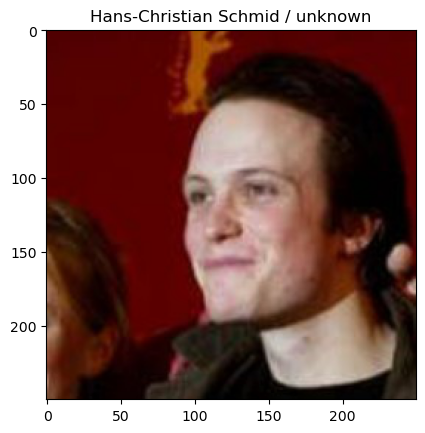

What do you think of this person?d
Hans-Christian Schmid saved on dislike


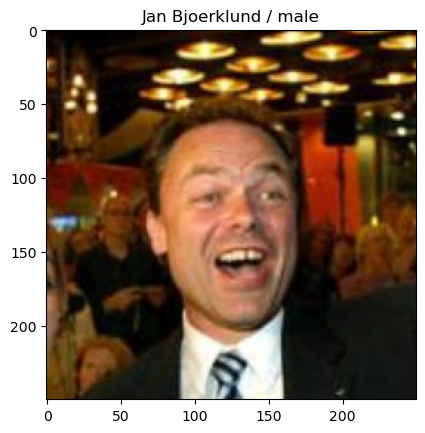

What do you think of this person?d
Jan Bjoerklund saved on dislike


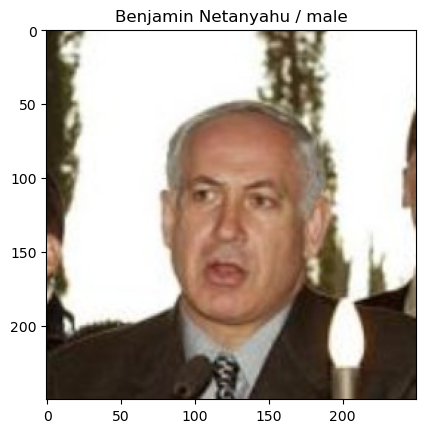

What do you think of this person?d
Benjamin Netanyahu saved on dislike


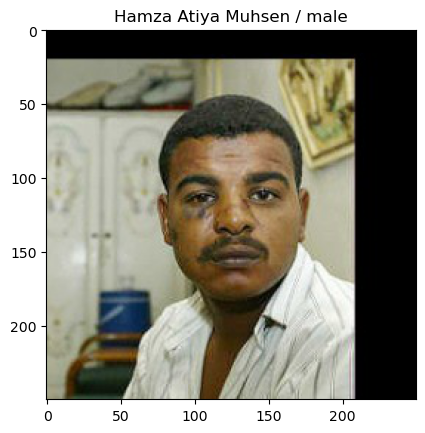

What do you think of this person?d
Hamza Atiya Muhsen saved on dislike


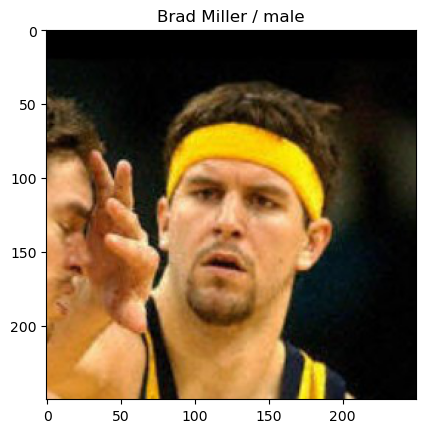

What do you think of this person?d
Brad Miller saved on dislike


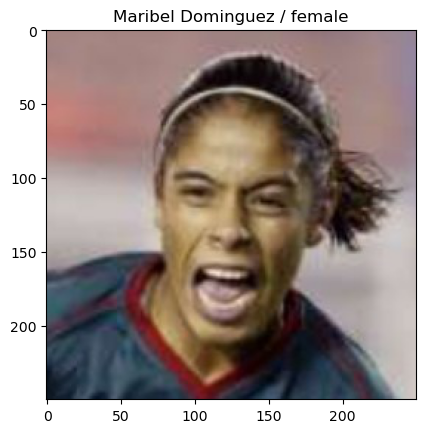

What do you think of this person?d
Maribel Dominguez saved on dislike


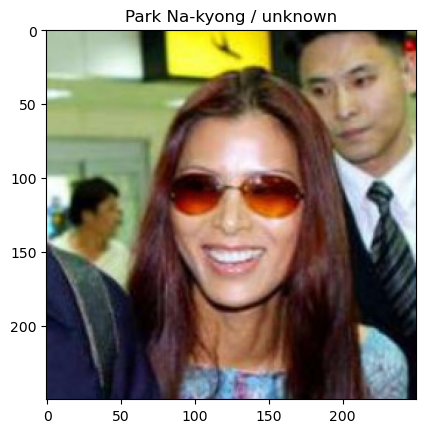

What do you think of this person?l
Park Na-kyong saved on like


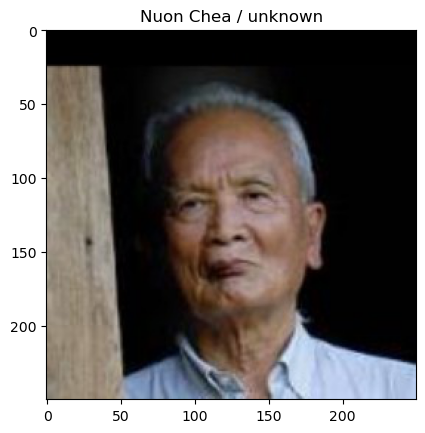

What do you think of this person?d
Nuon Chea saved on dislike


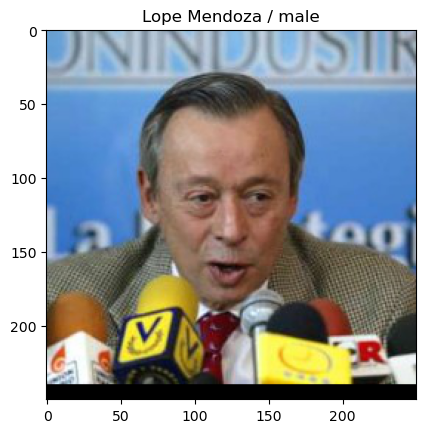

What do you think of this person?d
Lope Mendoza saved on dislike


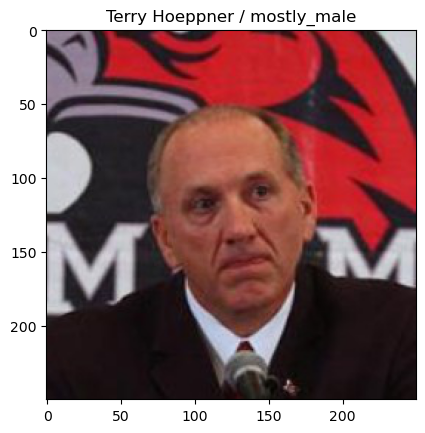

What do you think of this person?d
Terry Hoeppner saved on dislike


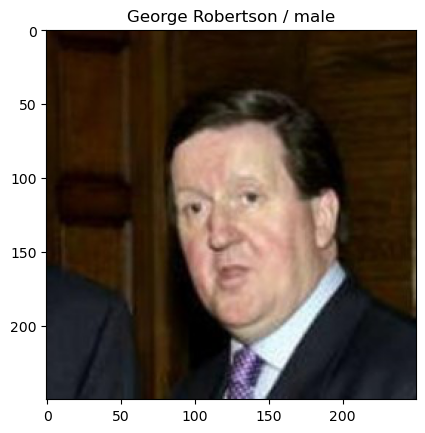

What do you think of this person?d
George Robertson saved on dislike


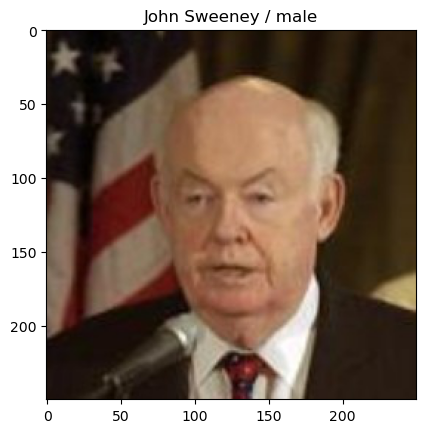

What do you think of this person?d
John Sweeney saved on dislike


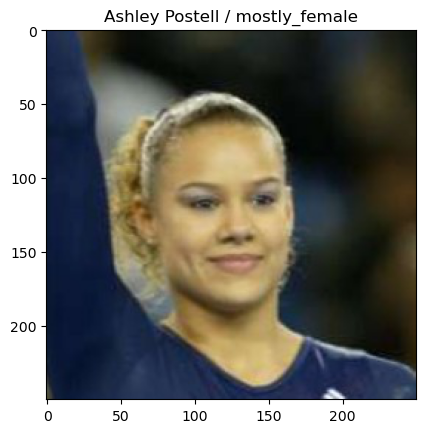

What do you think of this person?l
Ashley Postell saved on like


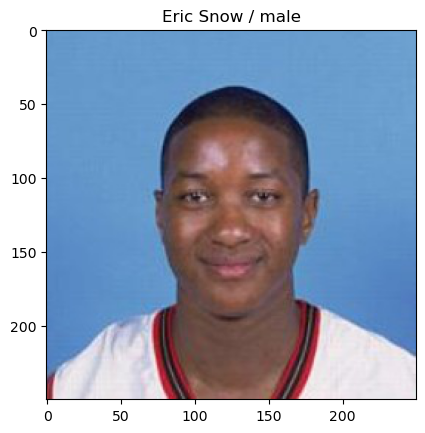

What do you think of this person?d
Eric Snow saved on dislike


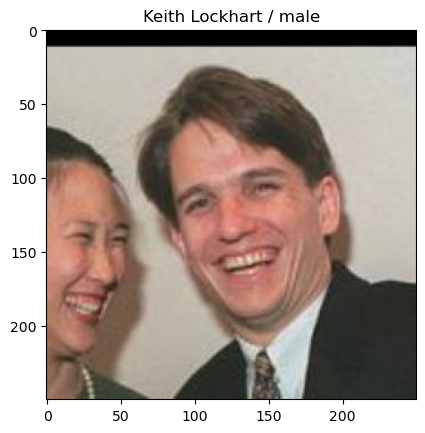

What do you think of this person?d
Keith Lockhart saved on dislike


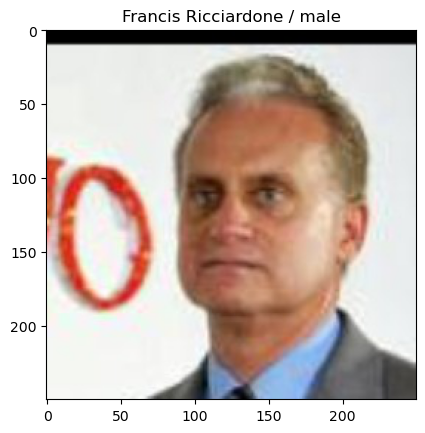

What do you think of this person?d
Francis Ricciardone saved on dislike


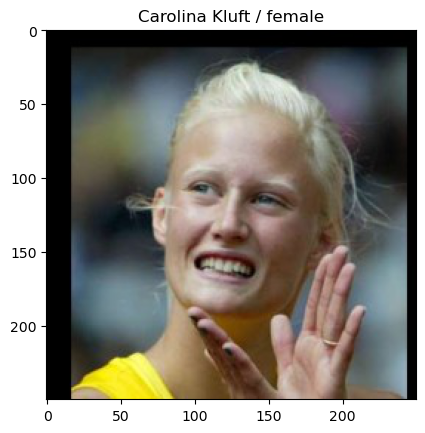

What do you think of this person?l
Carolina Kluft saved on like


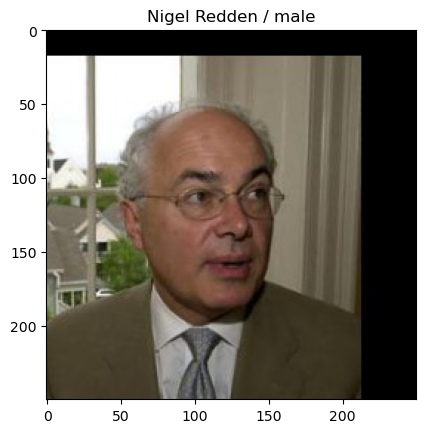

What do you think of this person?d
Nigel Redden saved on dislike


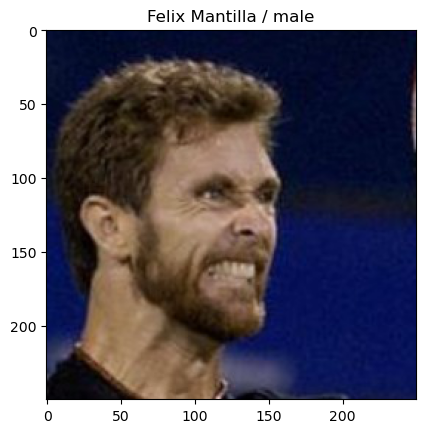

What do you think of this person?d
Felix Mantilla saved on dislike


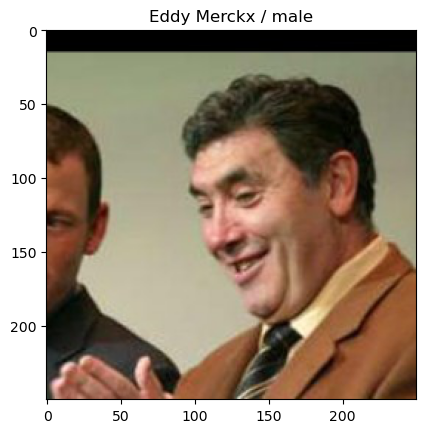

What do you think of this person?d
Eddy Merckx saved on dislike


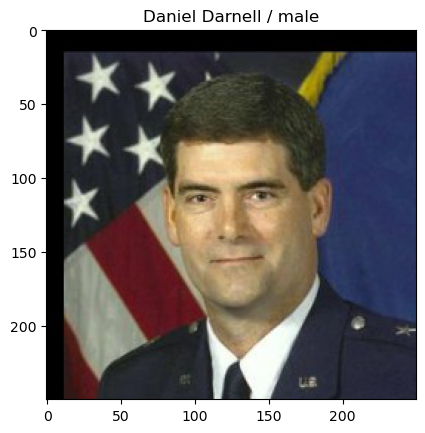

What do you think of this person?d
Daniel Darnell saved on dislike


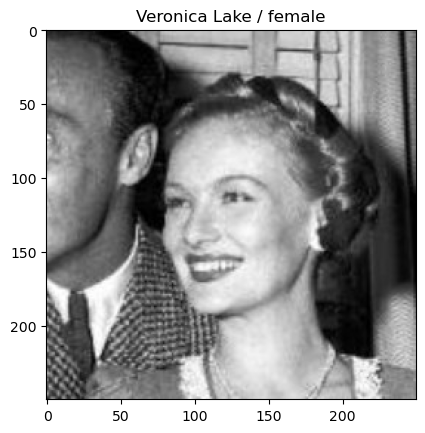

What do you think of this person?d
Veronica Lake saved on dislike


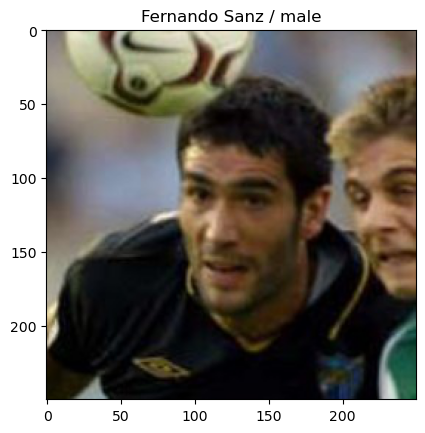

What do you think of this person?d
Fernando Sanz saved on dislike


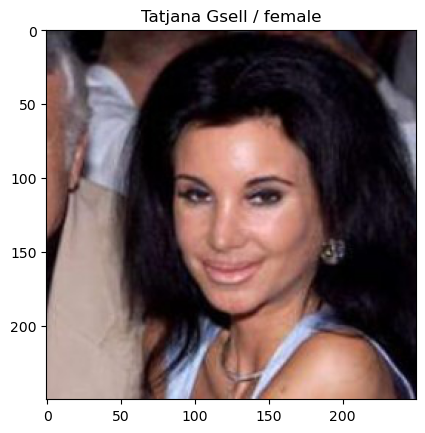

What do you think of this person?d
Tatjana Gsell saved on dislike


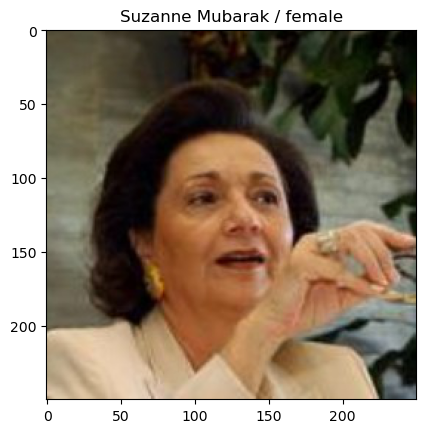

What do you think of this person?d
Suzanne Mubarak saved on dislike


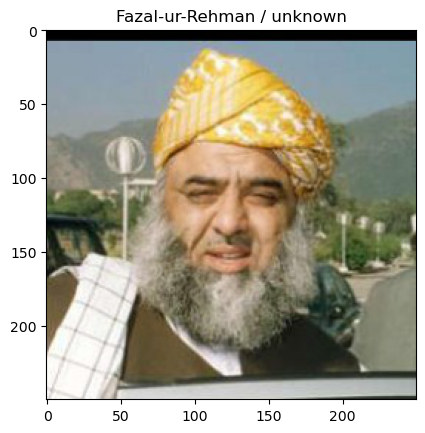

What do you think of this person?d
Fazal-ur-Rehman saved on dislike


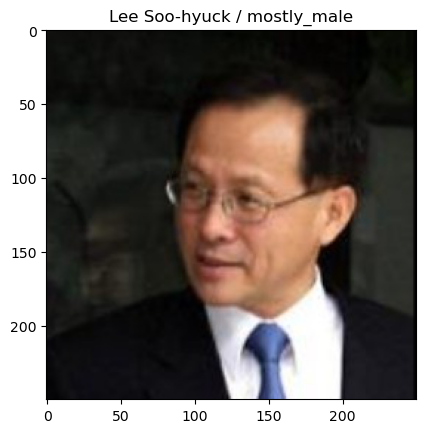

What do you think of this person?d
Lee Soo-hyuck saved on dislike


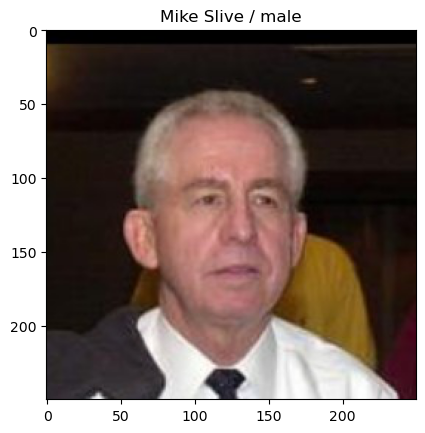

What do you think of this person?d
Mike Slive saved on dislike


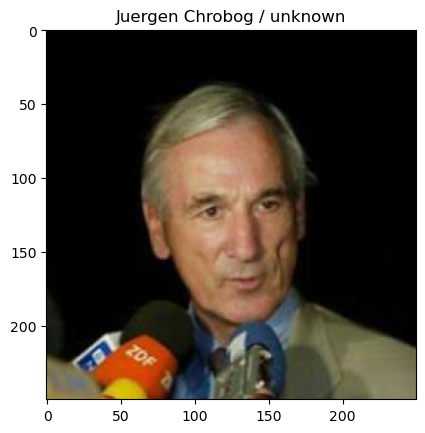

What do you think of this person?d
Juergen Chrobog saved on dislike


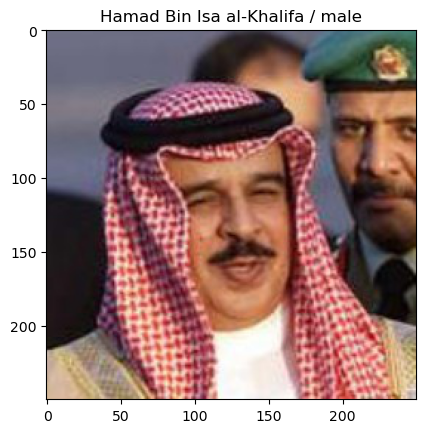

What do you think of this person?d
Hamad Bin Isa al-Khalifa saved on dislike


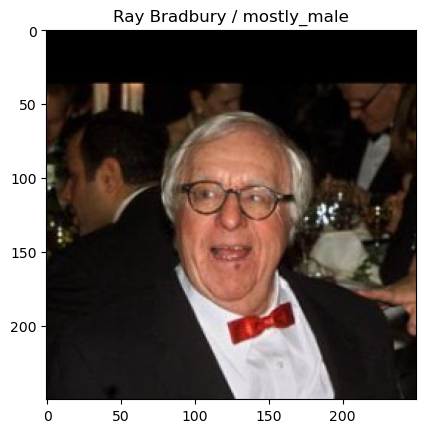

What do you think of this person?d
Ray Bradbury saved on dislike


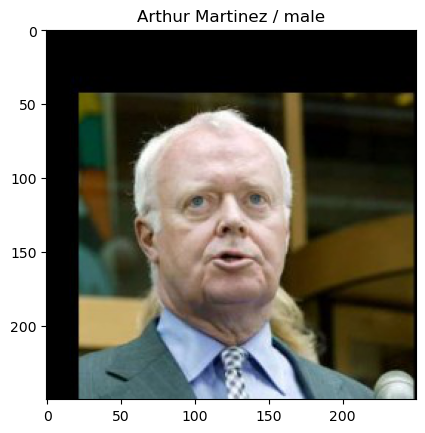

What do you think of this person?d
Arthur Martinez saved on dislike


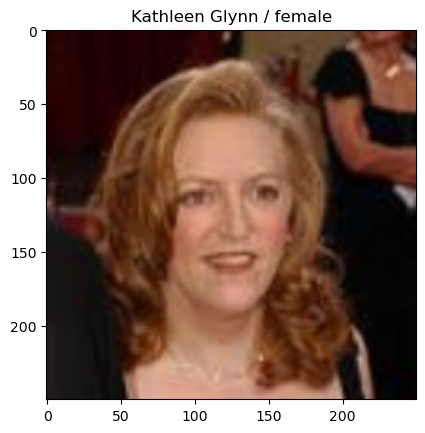

What do you think of this person?l
Kathleen Glynn saved on like


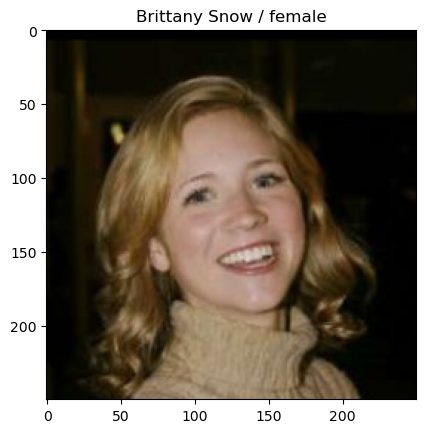

What do you think of this person?l
Brittany Snow saved on like


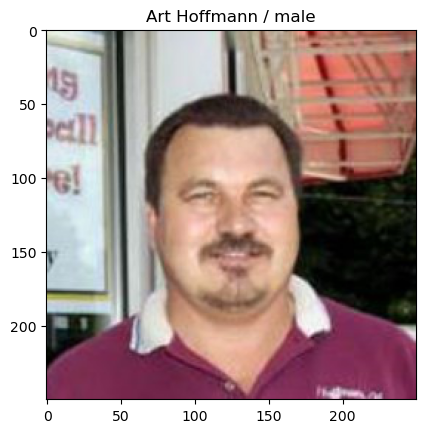

What do you think of this person?d
Art Hoffmann saved on dislike


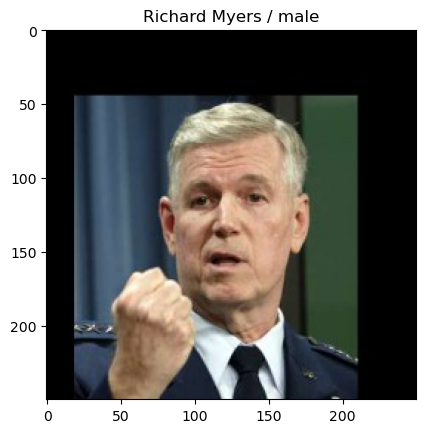

What do you think of this person?d
Richard Myers saved on dislike


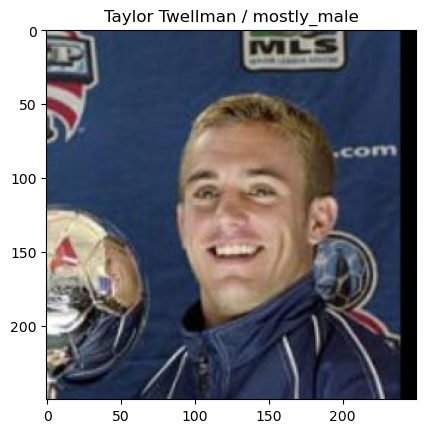

What do you think of this person?d
Taylor Twellman saved on dislike


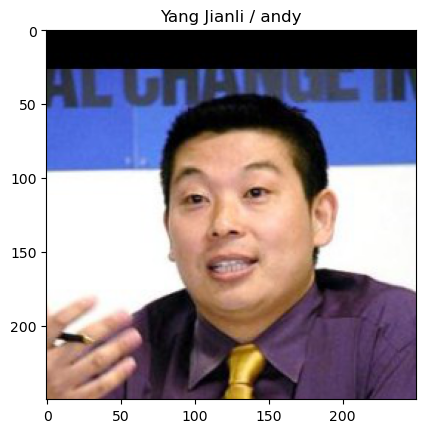

What do you think of this person?d
Yang Jianli saved on dislike


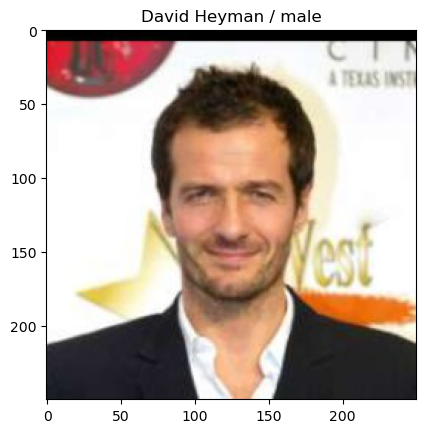

What do you think of this person?d
David Heyman saved on dislike


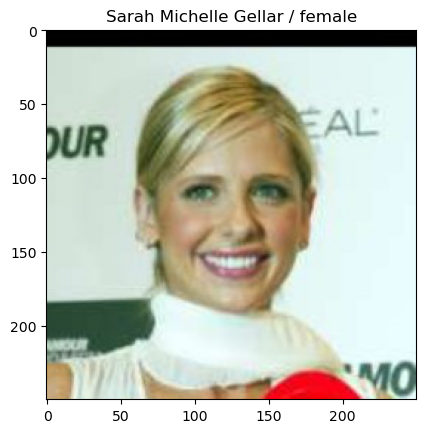

What do you think of this person?l
Sarah Michelle Gellar saved on like


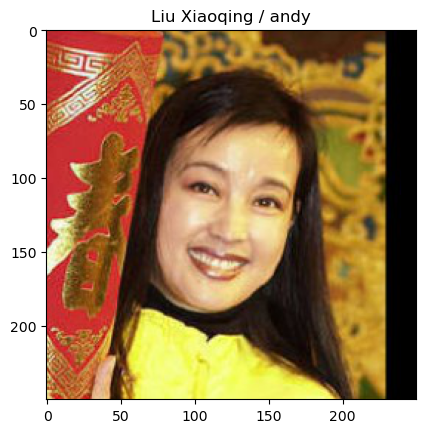

What do you think of this person?d
Liu Xiaoqing saved on dislike


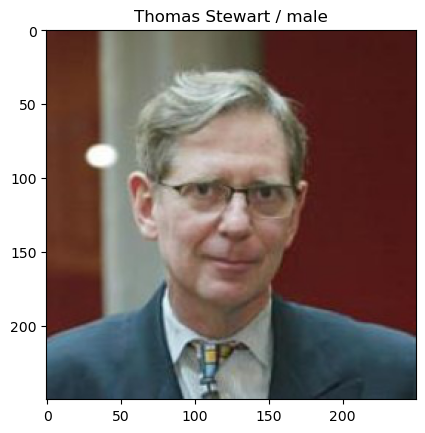

What do you think of this person?d
Thomas Stewart saved on dislike


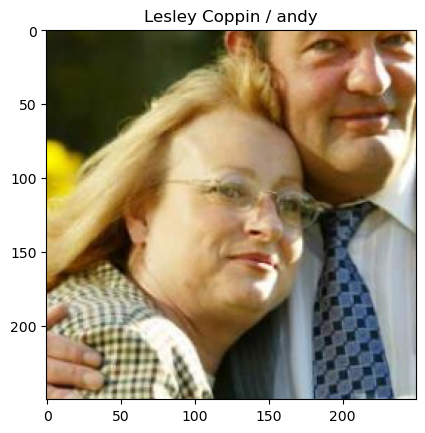

What do you think of this person?d
Lesley Coppin saved on dislike


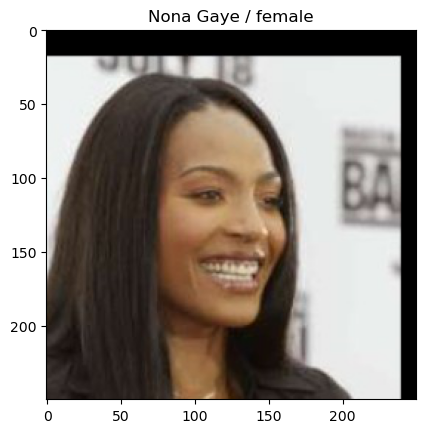

What do you think of this person?l
Nona Gaye saved on like


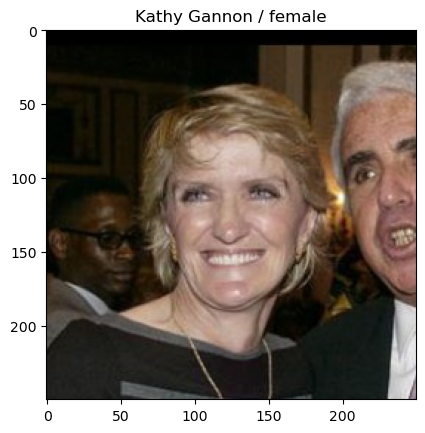

What do you think of this person?d
Kathy Gannon saved on dislike


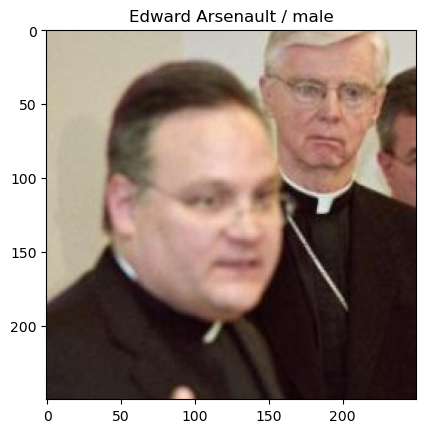

What do you think of this person?d
Edward Arsenault saved on dislike


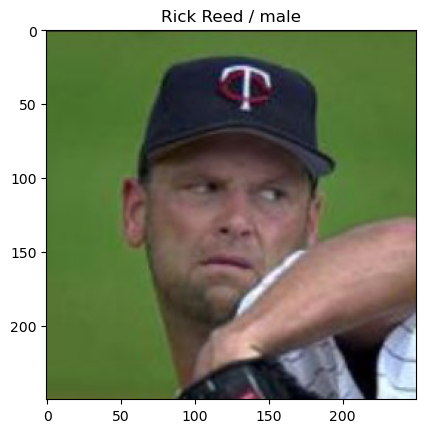

What do you think of this person?d
Rick Reed saved on dislike


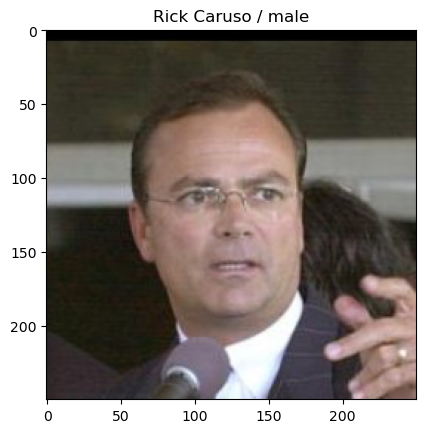

What do you think of this person?d
Rick Caruso saved on dislike


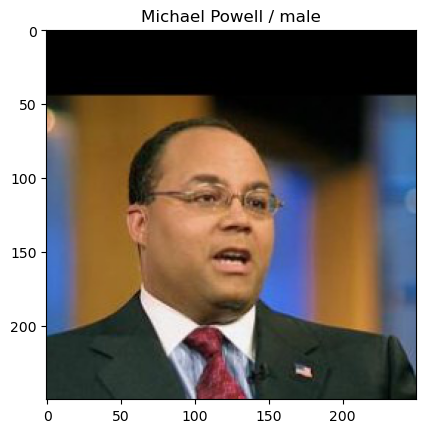

What do you think of this person?d
Michael Powell saved on dislike


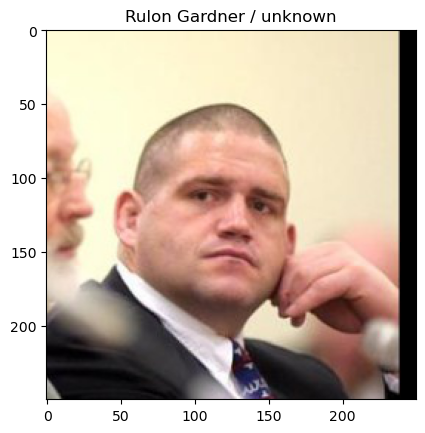

What do you think of this person?d
Rulon Gardner saved on dislike


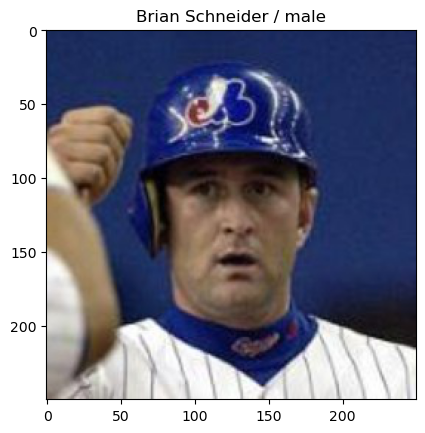

What do you think of this person?d
Brian Schneider saved on dislike


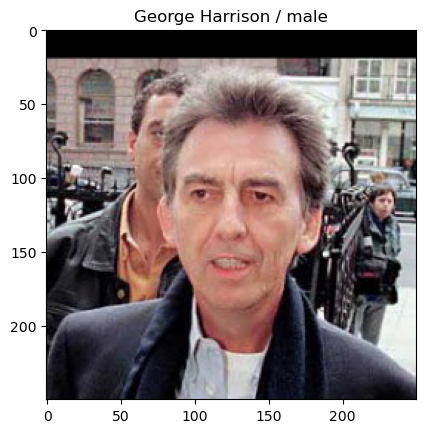

What do you think of this person?d
George Harrison saved on dislike


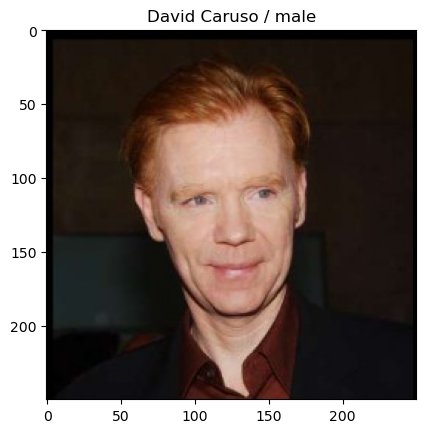

What do you think of this person?d
David Caruso saved on dislike


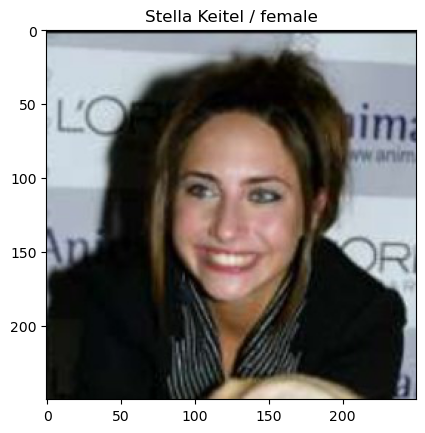

What do you think of this person?l
Stella Keitel saved on like


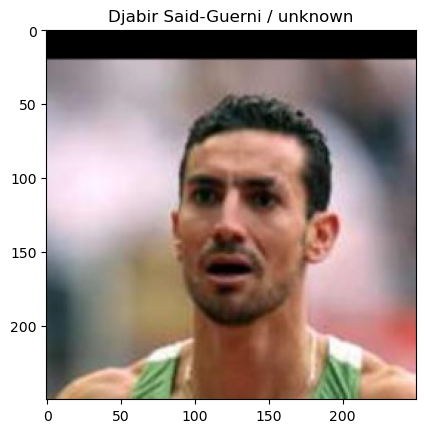

What do you think of this person?d
Djabir Said-Guerni saved on dislike


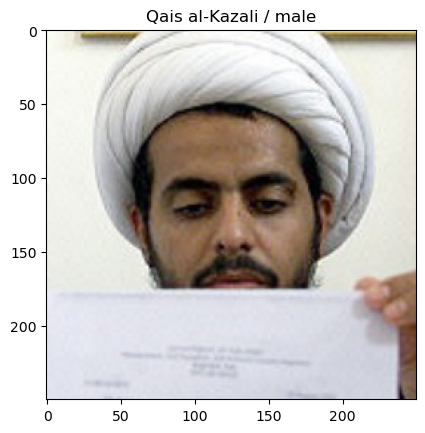

What do you think of this person?d
Qais al-Kazali saved on dislike


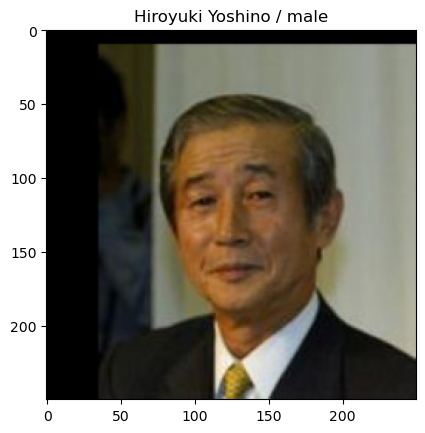

What do you think of this person?d
Hiroyuki Yoshino saved on dislike


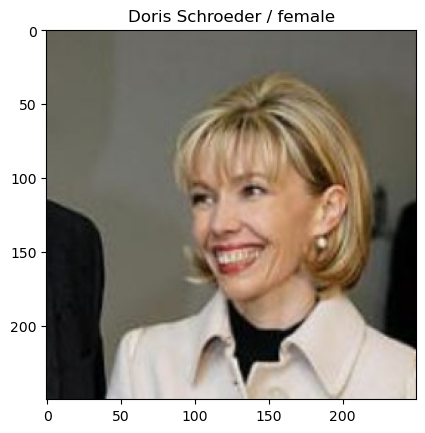

What do you think of this person?d
Doris Schroeder saved on dislike


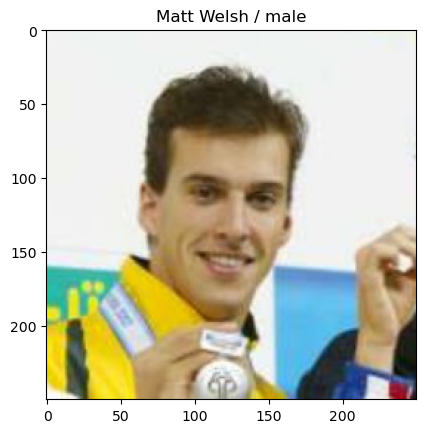

What do you think of this person?d
Matt Welsh saved on dislike


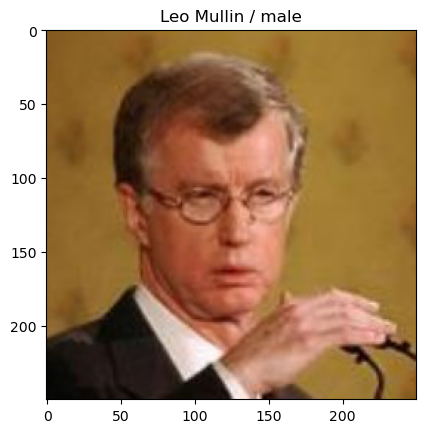

What do you think of this person?d
Leo Mullin saved on dislike


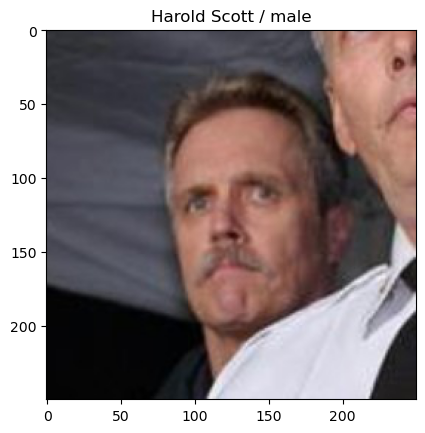

What do you think of this person?d
Harold Scott saved on dislike


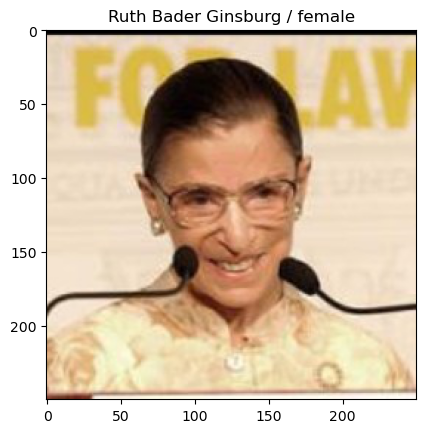

What do you think of this person?d
Ruth Bader Ginsburg saved on dislike


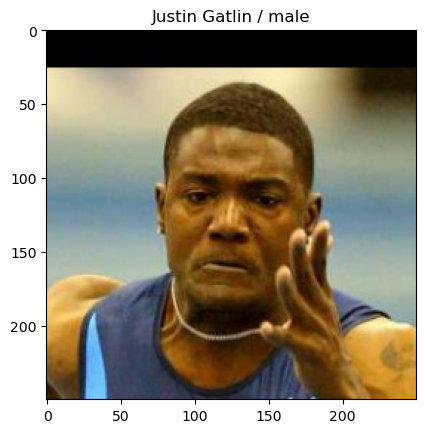

What do you think of this person?d
Justin Gatlin saved on dislike


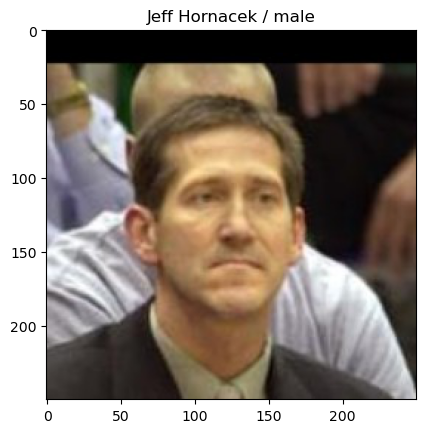

What do you think of this person?d
Jeff Hornacek saved on dislike


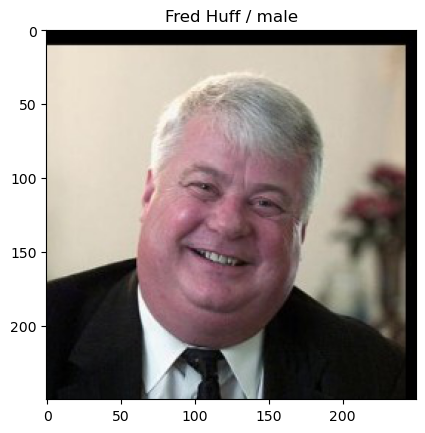

What do you think of this person?d
Fred Huff saved on dislike


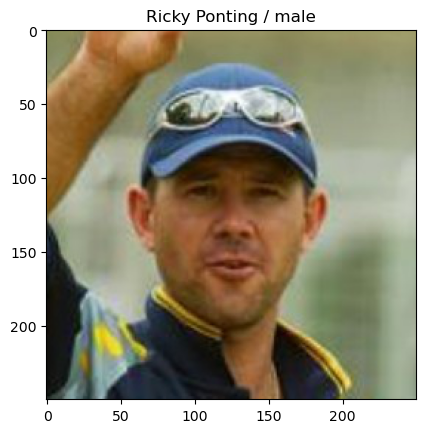

What do you think of this person?d
Ricky Ponting saved on dislike


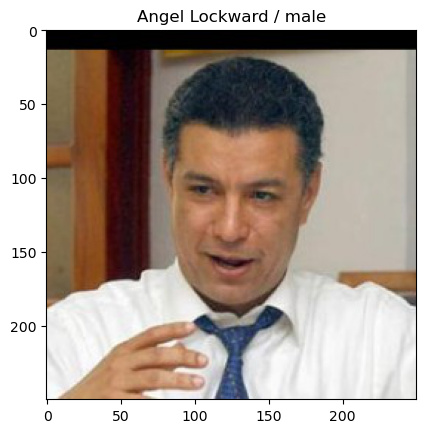

What do you think of this person?d
Angel Lockward saved on dislike


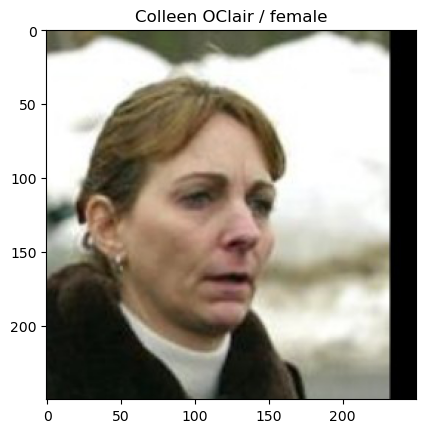

What do you think of this person?d
Colleen OClair saved on dislike


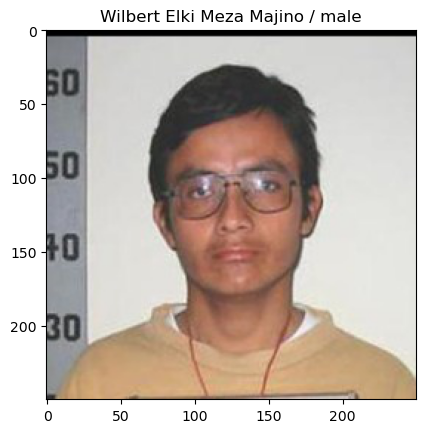

What do you think of this person?d
Wilbert Elki Meza Majino saved on dislike


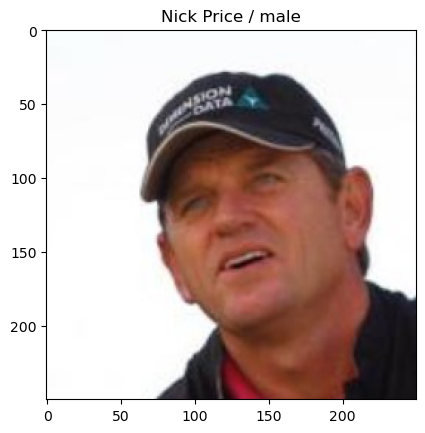

What do you think of this person?d
Nick Price saved on dislike


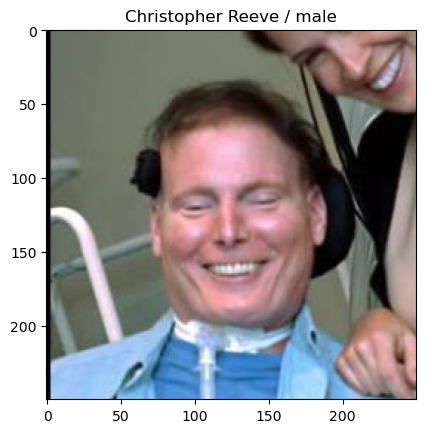

What do you think of this person?d
Christopher Reeve saved on dislike


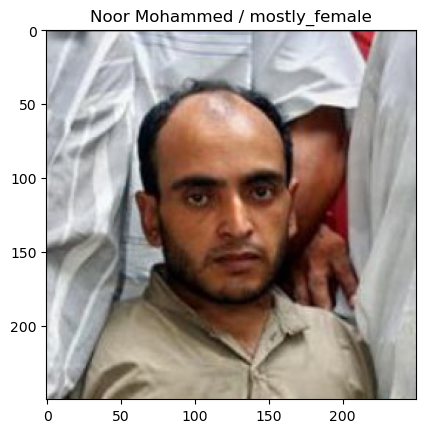

What do you think of this person?d
Noor Mohammed saved on dislike


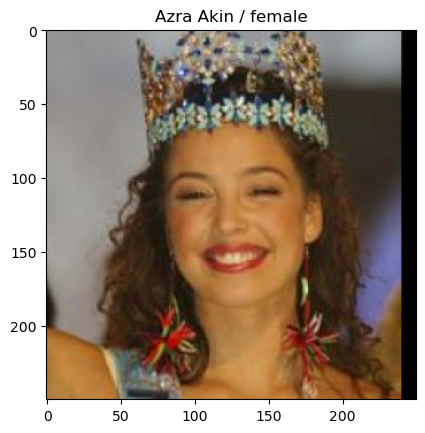

What do you think of this person?l
Azra Akin saved on like


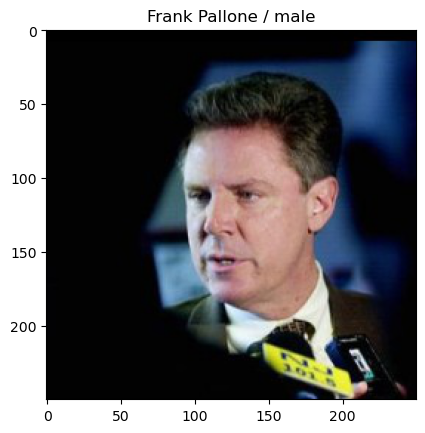

What do you think of this person?d
Frank Pallone saved on dislike


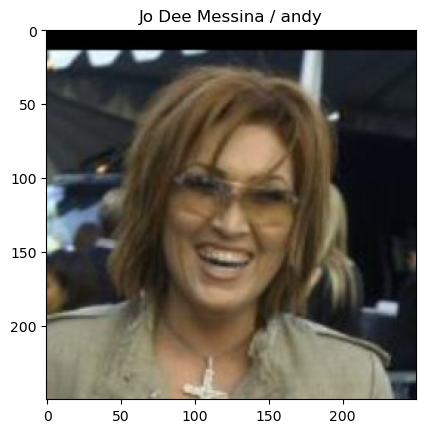

What do you think of this person?d
Jo Dee Messina saved on dislike


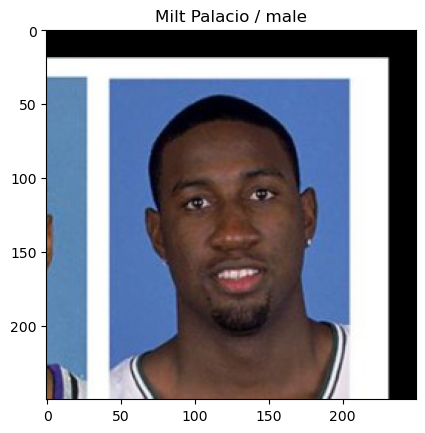

What do you think of this person?d
Milt Palacio saved on dislike


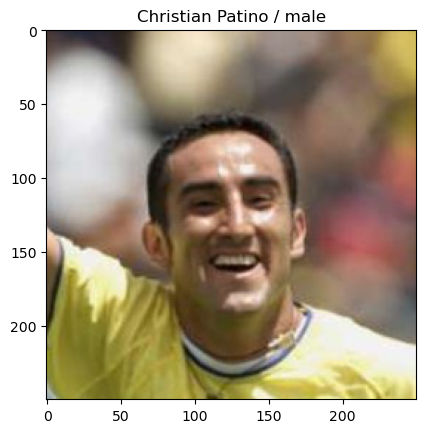

What do you think of this person?d
Christian Patino saved on dislike


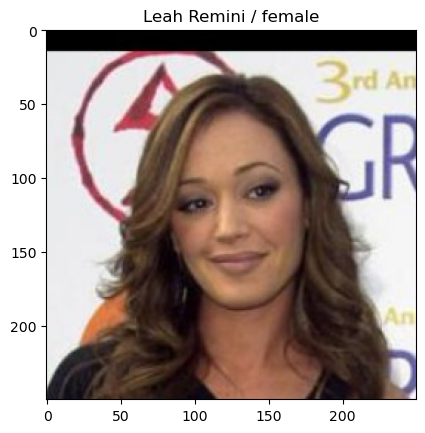

What do you think of this person?l
Leah Remini saved on like


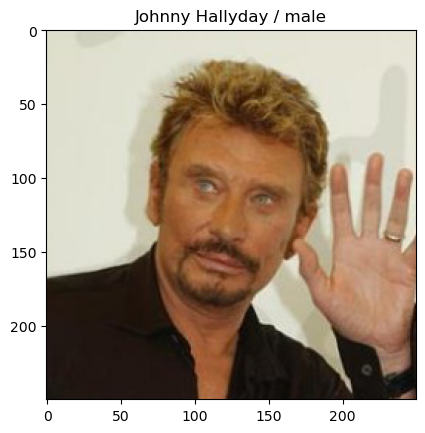

What do you think of this person?d
Johnny Hallyday saved on dislike


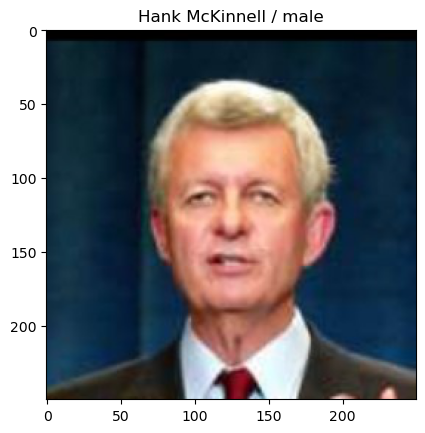

What do you think of this person?d
Hank McKinnell saved on dislike


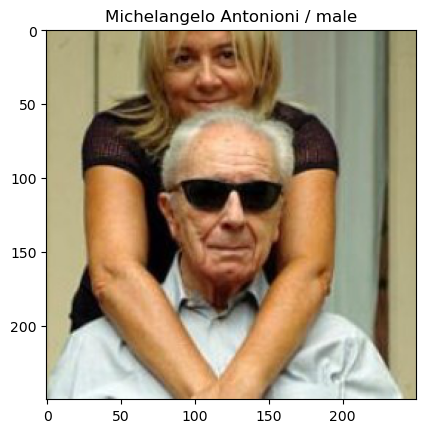

What do you think of this person?d
Michelangelo Antonioni saved on dislike


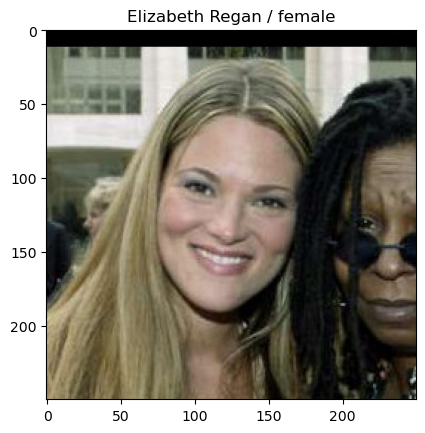

What do you think of this person?l
Elizabeth Regan saved on like


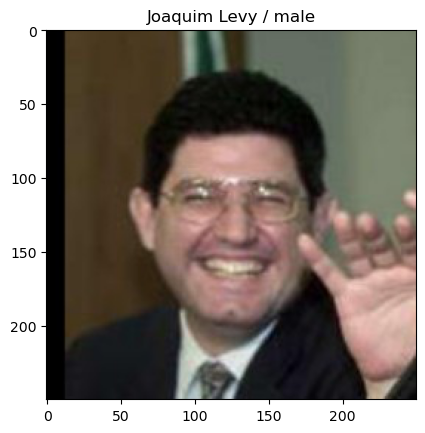

What do you think of this person?d
Joaquim Levy saved on dislike


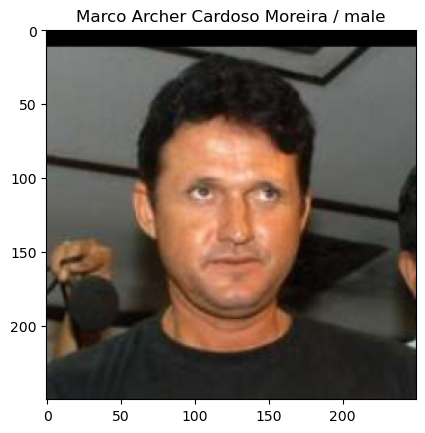

What do you think of this person?d
Marco Archer Cardoso Moreira saved on dislike


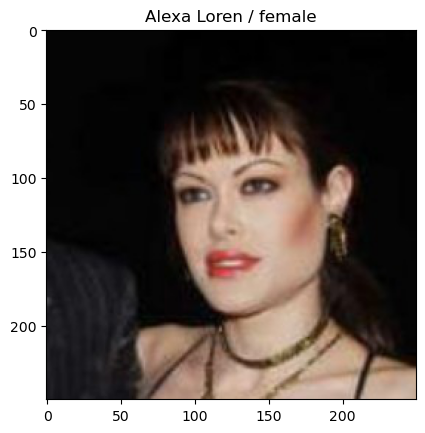

What do you think of this person?l
Alexa Loren saved on like


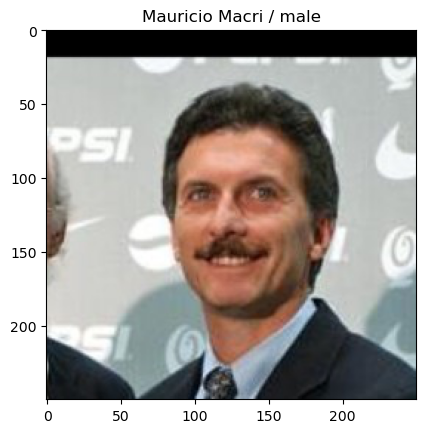

What do you think of this person?d
Mauricio Macri saved on dislike


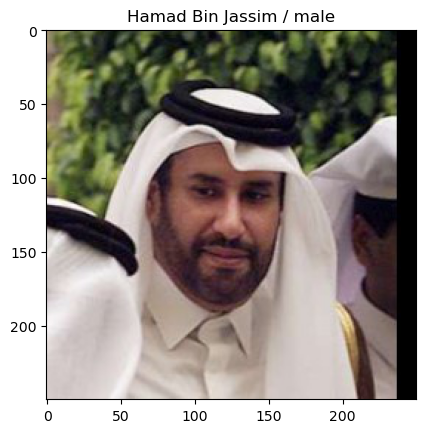

What do you think of this person?d
Hamad Bin Jassim saved on dislike


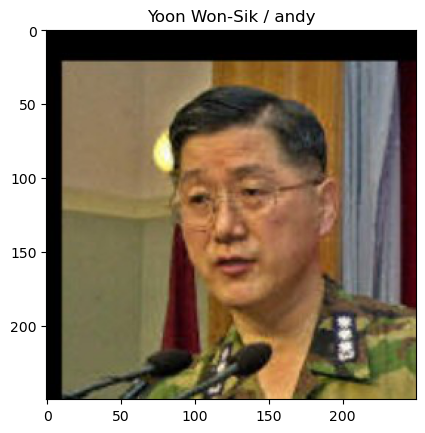

What do you think of this person?d
Yoon Won-Sik saved on dislike


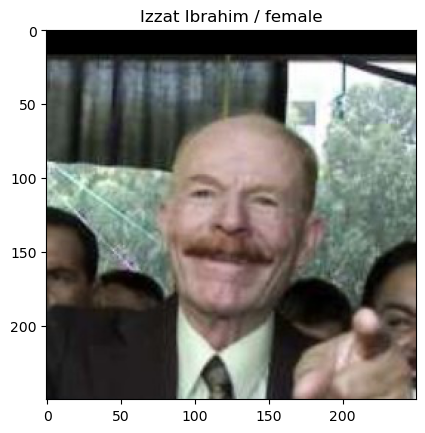

What do you think of this person?d
Izzat Ibrahim saved on dislike


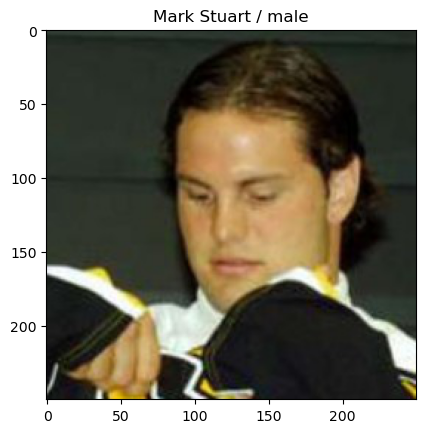

What do you think of this person?d
Mark Stuart saved on dislike


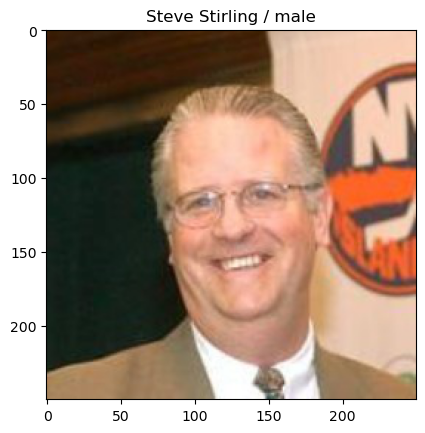

What do you think of this person?d
Steve Stirling saved on dislike


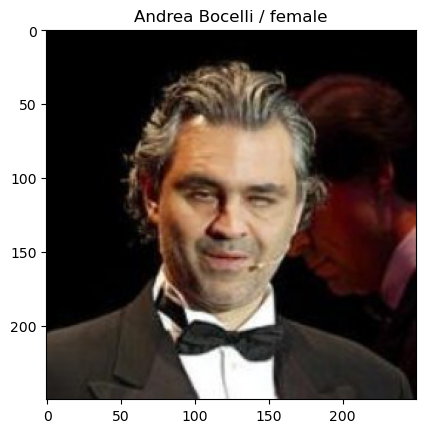

What do you think of this person?d
Andrea Bocelli saved on dislike


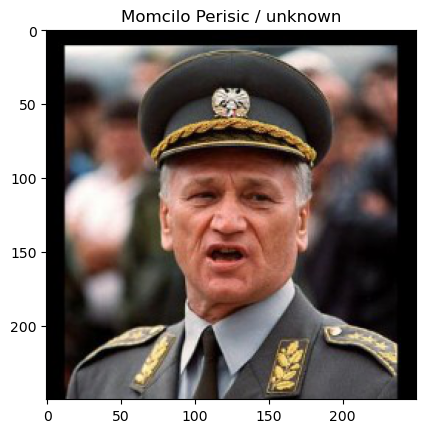

What do you think of this person?d
Momcilo Perisic saved on dislike


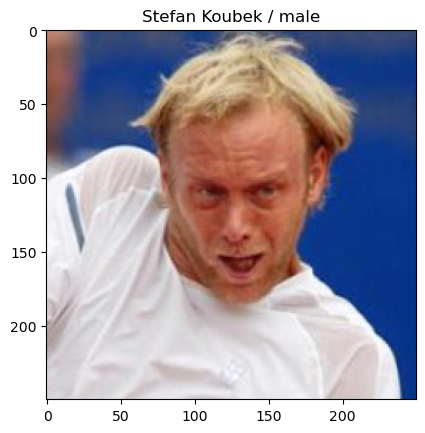

What do you think of this person?d
Stefan Koubek saved on dislike


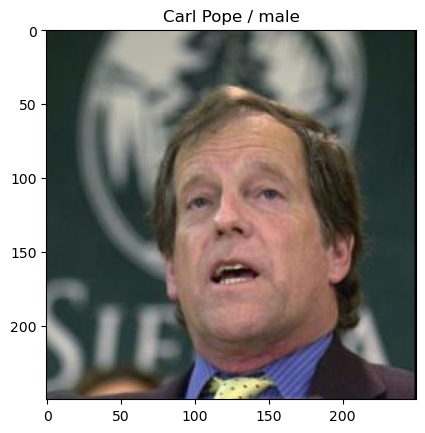

What do you think of this person?d
Carl Pope saved on dislike


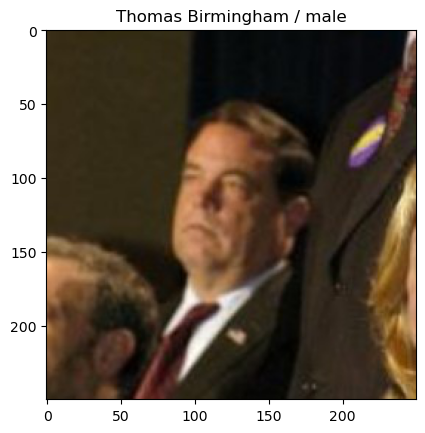

What do you think of this person?d
Thomas Birmingham saved on dislike


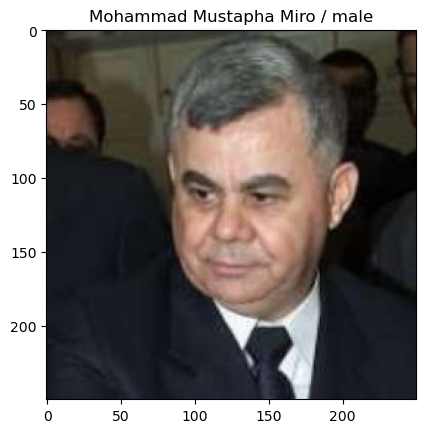

What do you think of this person?d
Mohammad Mustapha Miro saved on dislike


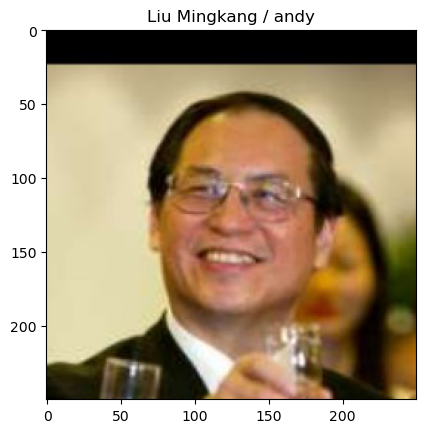

What do you think of this person?d
Liu Mingkang saved on dislike


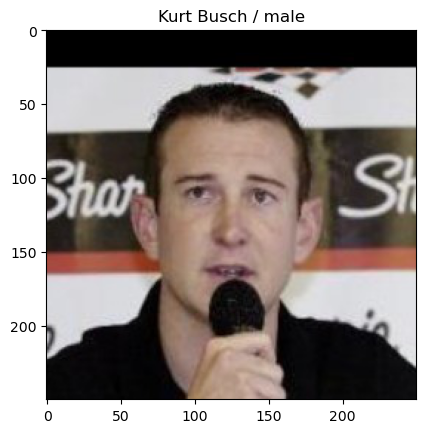

What do you think of this person?d
Kurt Busch saved on dislike


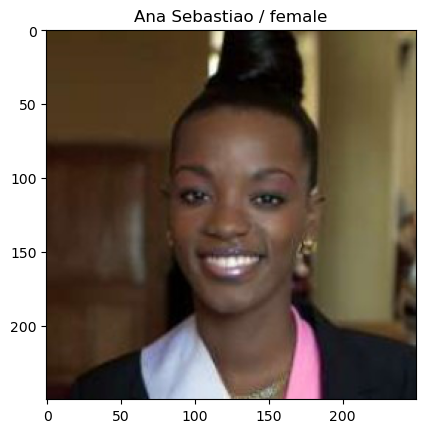

What do you think of this person?l
Ana Sebastiao saved on like


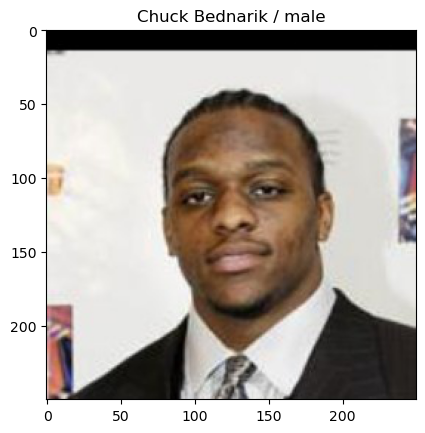

What do you think of this person?d
Chuck Bednarik saved on dislike


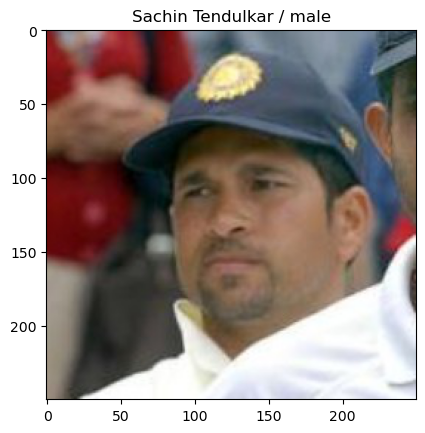

What do you think of this person?d
Sachin Tendulkar saved on dislike


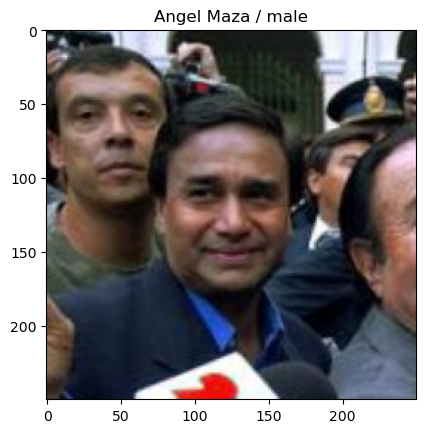

What do you think of this person?d
Angel Maza saved on dislike


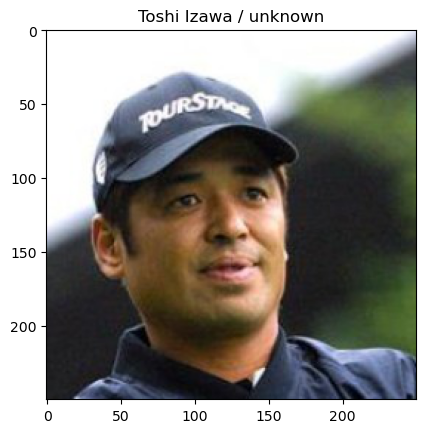

What do you think of this person?d
Toshi Izawa saved on dislike


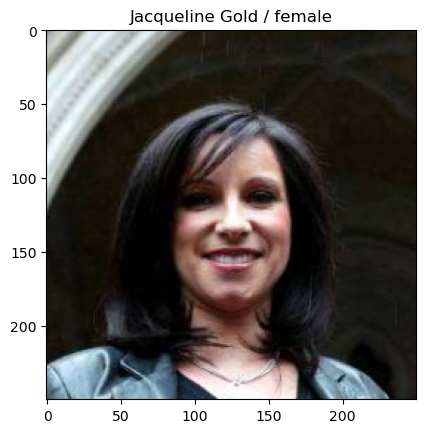

What do you think of this person?l
Jacqueline Gold saved on like


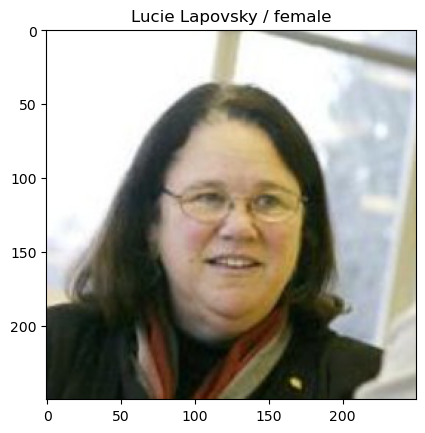

What do you think of this person?d
Lucie Lapovsky saved on dislike


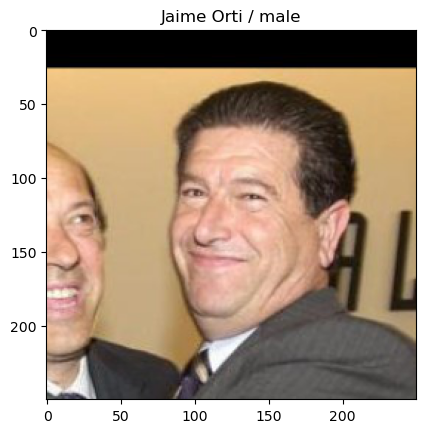

What do you think of this person?d
Jaime Orti saved on dislike


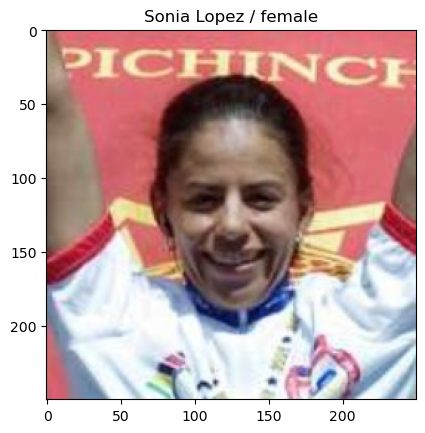

What do you think of this person?d
Sonia Lopez saved on dislike


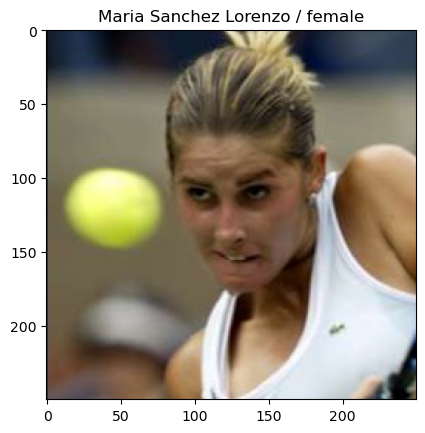

What do you think of this person?d
Maria Sanchez Lorenzo saved on dislike


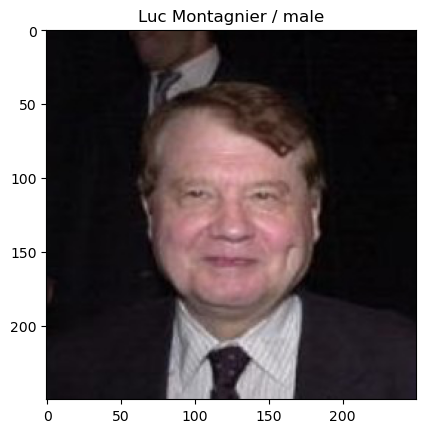

What do you think of this person?d
Luc Montagnier saved on dislike


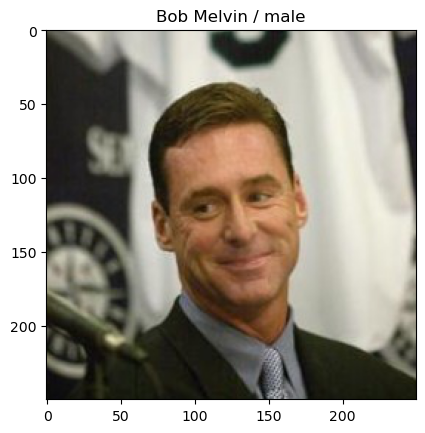

What do you think of this person?d
Bob Melvin saved on dislike


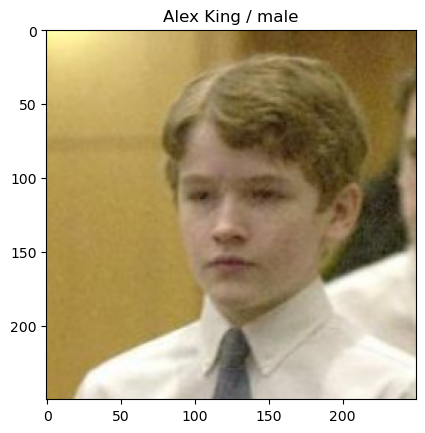

What do you think of this person?d
Alex King saved on dislike


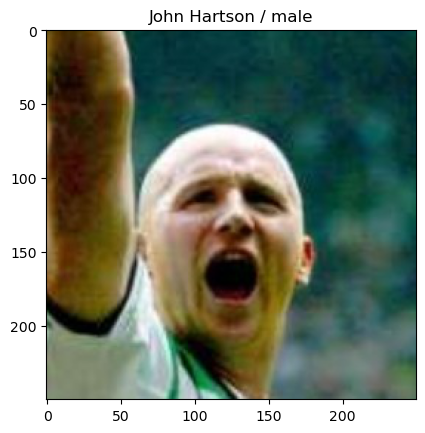

What do you think of this person?d
John Hartson saved on dislike


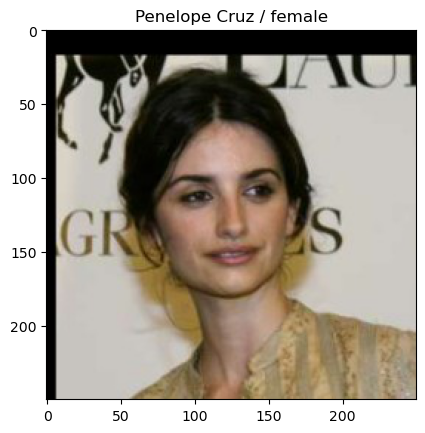

What do you think of this person?l
Penelope Cruz saved on like


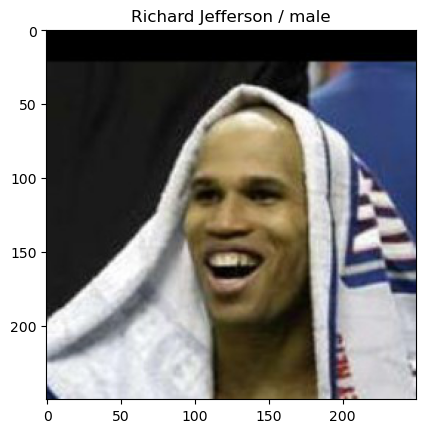

What do you think of this person?d
Richard Jefferson saved on dislike


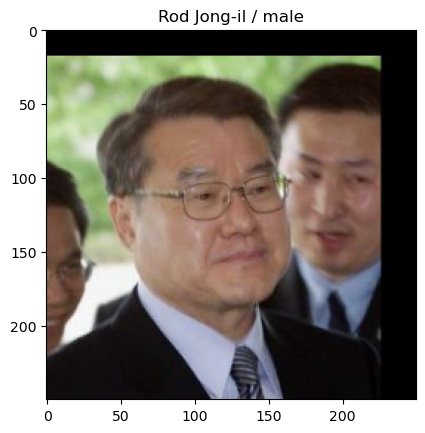

What do you think of this person?d
Rod Jong-il saved on dislike


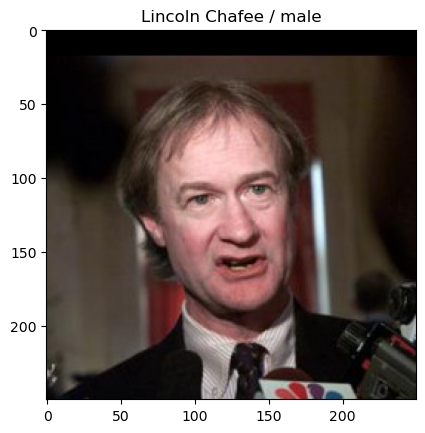

What do you think of this person?d
Lincoln Chafee saved on dislike


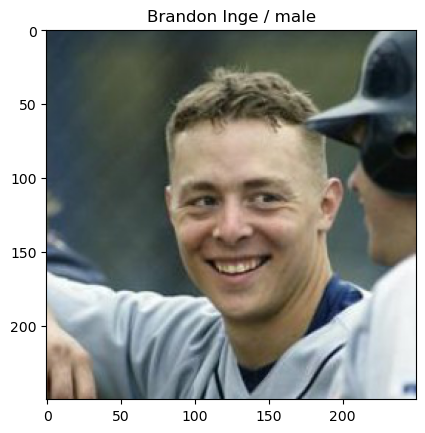

What do you think of this person?d
Brandon Inge saved on dislike


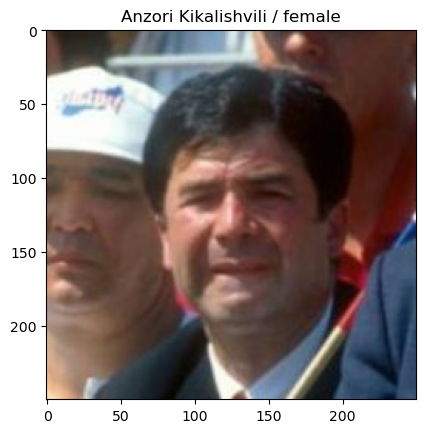

What do you think of this person?d
Anzori Kikalishvili saved on dislike


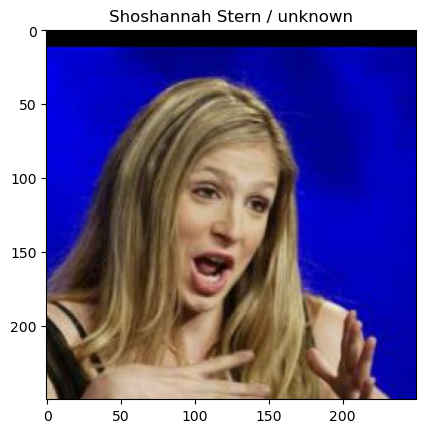

What do you think of this person?l
Shoshannah Stern saved on like


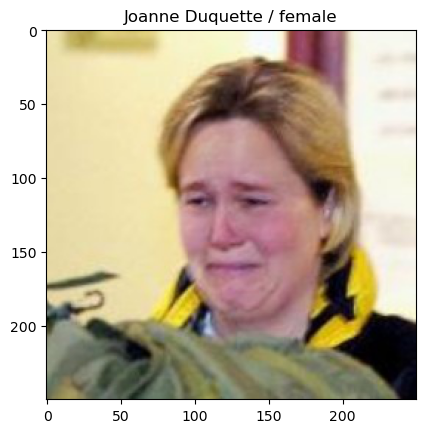

What do you think of this person?d
Joanne Duquette saved on dislike


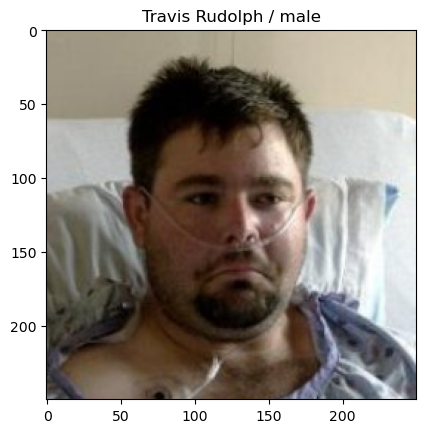

What do you think of this person?d
Travis Rudolph saved on dislike


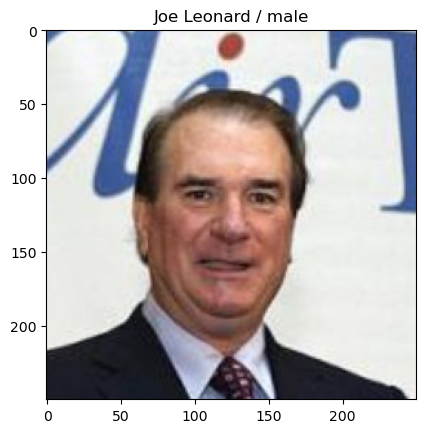

What do you think of this person?d
Joe Leonard saved on dislike


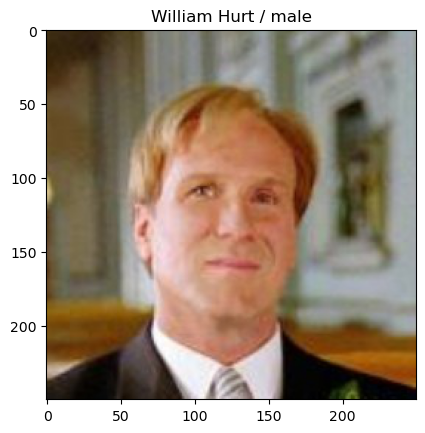

What do you think of this person?d
William Hurt saved on dislike


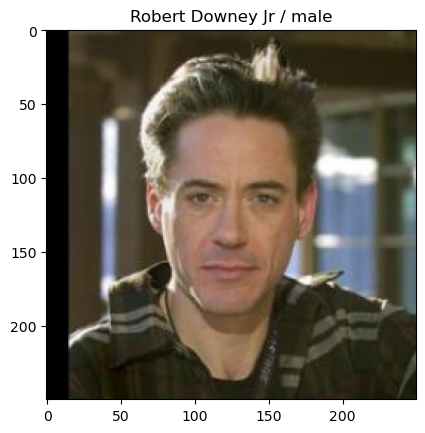

What do you think of this person?d
Robert Downey Jr saved on dislike


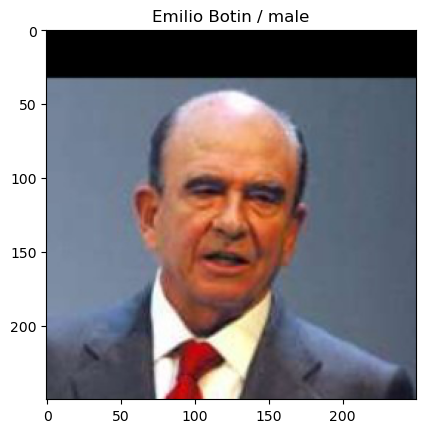

What do you think of this person?d
Emilio Botin saved on dislike


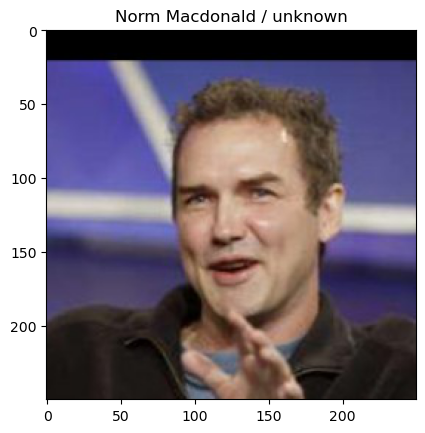

What do you think of this person?d
Norm Macdonald saved on dislike


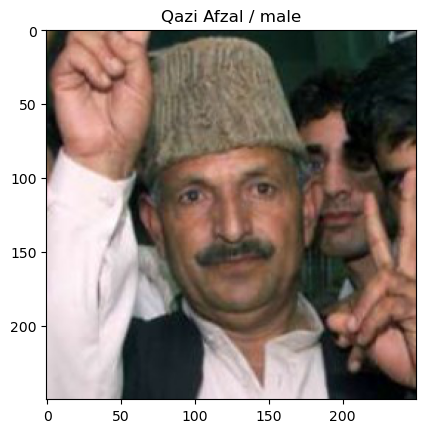

What do you think of this person?d
Qazi Afzal saved on dislike


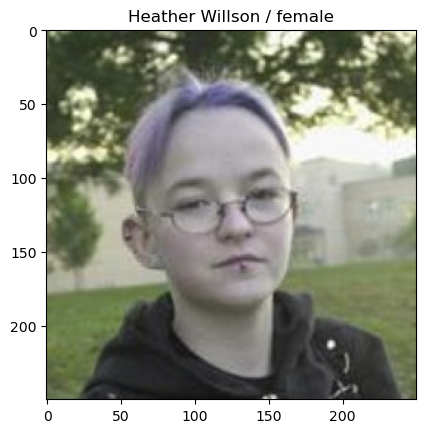

What do you think of this person?d
Heather Willson saved on dislike


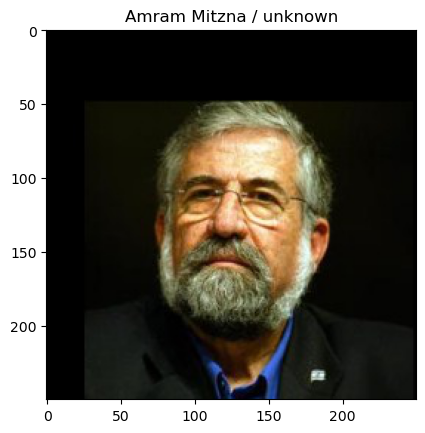

What do you think of this person?d
Amram Mitzna saved on dislike


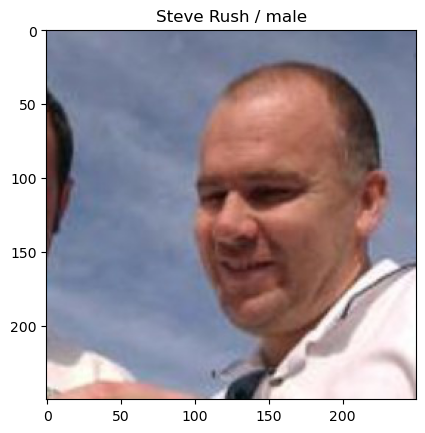

What do you think of this person?d
Steve Rush saved on dislike


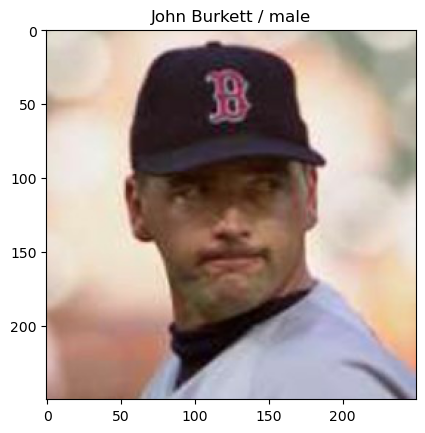

What do you think of this person?d
John Burkett saved on dislike


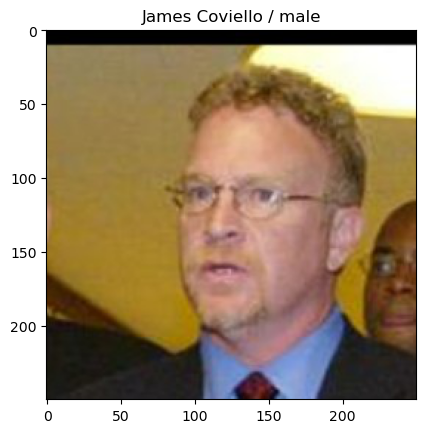

What do you think of this person?d
James Coviello saved on dislike


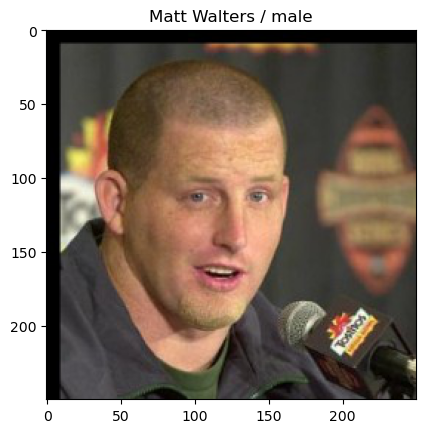

What do you think of this person?d
Matt Walters saved on dislike


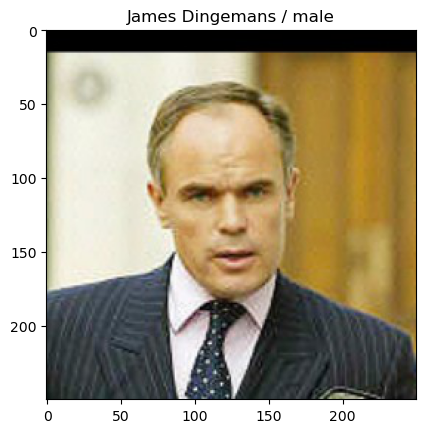

What do you think of this person?d
James Dingemans saved on dislike


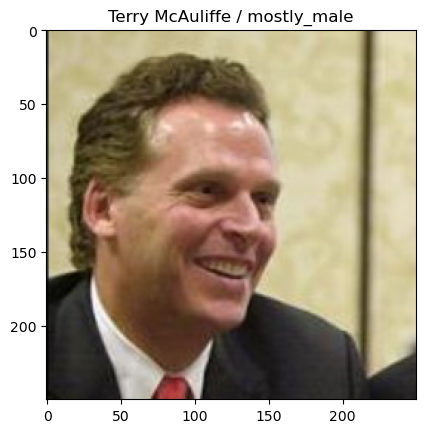

What do you think of this person?d
Terry McAuliffe saved on dislike


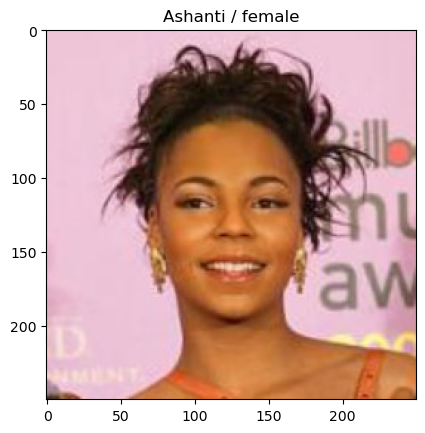

What do you think of this person?l
Ashanti saved on like


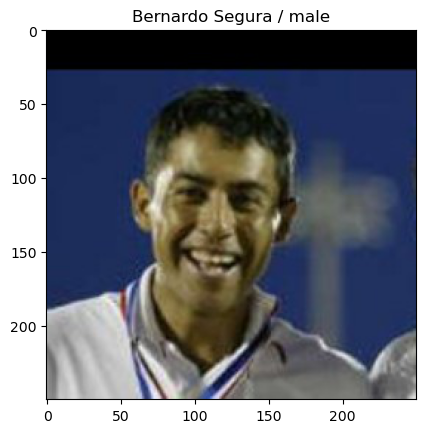

What do you think of this person?d
Bernardo Segura saved on dislike


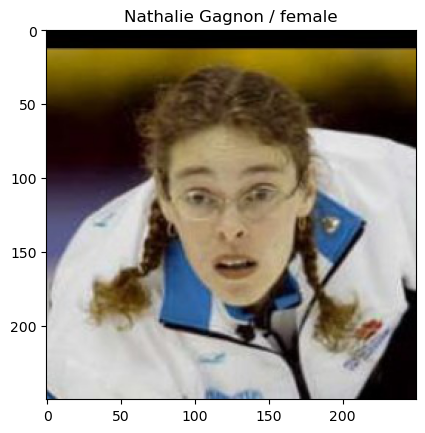

What do you think of this person?l
Nathalie Gagnon saved on like


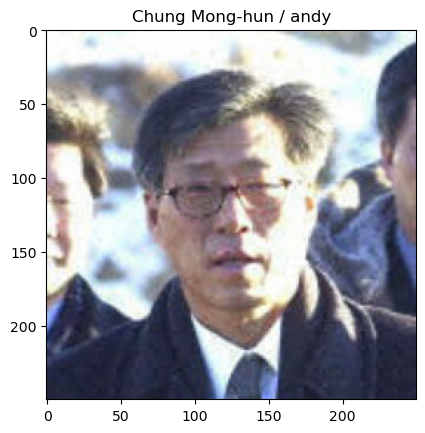

What do you think of this person?d
Chung Mong-hun saved on dislike


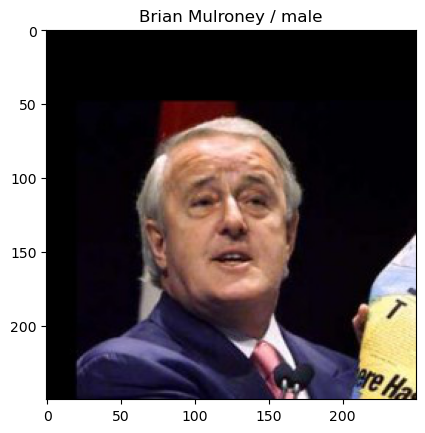

What do you think of this person?d
Brian Mulroney saved on dislike


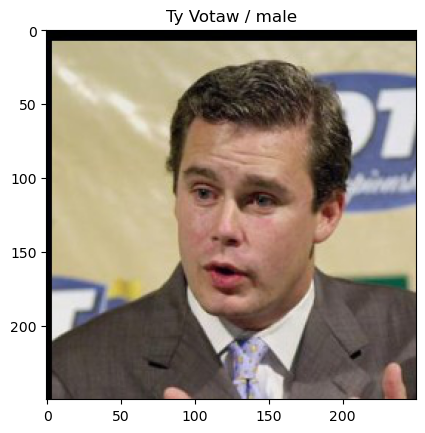

What do you think of this person?d
Ty Votaw saved on dislike


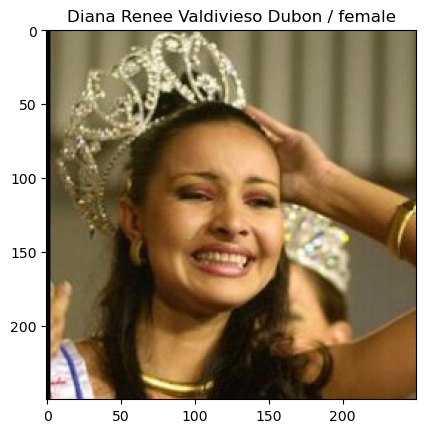

What do you think of this person?l
Diana Renee Valdivieso Dubon saved on like


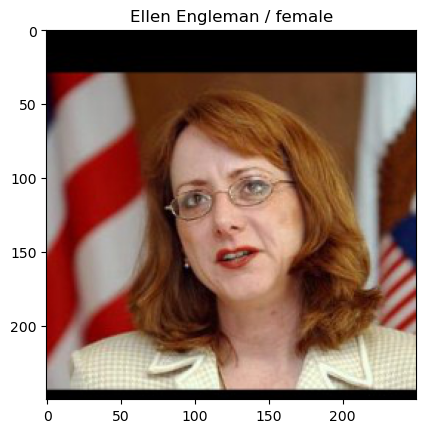

What do you think of this person?d
Ellen Engleman saved on dislike


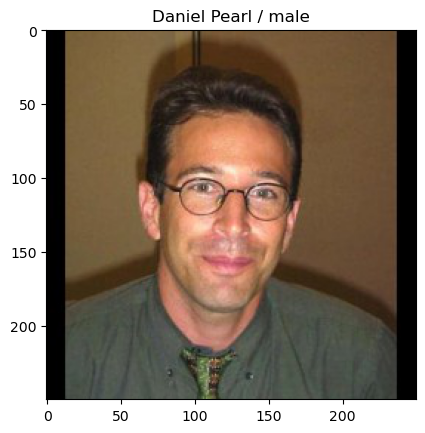

What do you think of this person?end
------------ENDING----------


In [216]:
users = os.listdir(LFW_DIR)
random.shuffle(users)
for directory in users:
    if directory == '.DS_Store':
        continue
    username = directory.replace('_', ' ')
    gender = d.get_gender(username.split()[0])
    answer = save_user_swipe(username, gender, os.path.join(LFW_DIR, directory))
    if answer == 'end':
        break

In [176]:
# Test all women
for directory in os.listdir(LFW_DIR):
    if directory == '.DS_Store':
        continue
    username = directory.replace('_', ' ')
    gender = d.get_gender(username.split()[0])
    if gender == 'female' or gender == 'mostly_female':
        shutil.copytree(os.path.join(LFW_DIR, directory), LIKE_PATH, dirs_exist_ok=True)
    else:
        shutil.copytree(os.path.join(LFW_DIR, directory), DISLIKE_PATH, dirs_exist_ok=True)
        